In [1]:
library(dplyr)
library(Seurat)
library(patchwork)
library(ggplot2)
library(viridis)
library(ggpointdensity)
library(monocle3)
library(ggrepel)
library(SeuratWrappers)
library(ggridges)
library(enrichR)
library(ggrastr)

umap_theme <- theme(
  axis.line=element_blank(),
  axis.text.x=element_blank(),
  axis.text.y=element_blank(),
  axis.ticks=element_blank(),
  axis.title.x=element_blank(),
  axis.title.y=element_blank(),
  panel.background=element_blank(),
  panel.border=element_blank(),
  panel.grid.major=element_blank(),
  panel.grid.minor=element_blank()
)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Attaching SeuratObject

Warning message:
“package ‘patchwork’ was built under R version 4.2.1”
Warning message:
“package ‘ggplot2’ was built under R version 4.2.3”
Warning message:
“package ‘viridis’ was built under R version 4.2.1”
Loading required package: viridisLite

Warning message:
“package ‘viridisLite’ was built under R version 4.2.1”
Warning message:
“package ‘monocle3’ was built under R version 4.2.2”
Loading required package: Biobase

Warning message:
“package ‘Biobase’ was built under R version 4.2.1”
Loading required package: BiocGenerics

Warning message:
“package ‘BiocGenerics’ was built under R version 4.2.1”

Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked

In [2]:
ery = readRDS("230424_ery_seurat.rds")
klein.combined = readRDS("230424_klein_combined_seurat.rds")

# Seurat

In [2]:
ery.data <- Read10X(data.dir = "/net/bmc-pub17/data/bmc/public/Vanderheiden/230322Van/10x-6181L/D23-4580/outs/raw_feature_bc_matrix")
ery <- CreateSeuratObject(counts = ery.data, project = "ery", min.cells = 3, min.features = 200)
ery

An object of class Seurat 
23676 features across 15313 samples within 1 assay 
Active assay: RNA (23676 features, 0 variable features)

In [3]:
ery[["percent.mt"]] <- PercentageFeatureSet(ery, pattern = "^MT-")

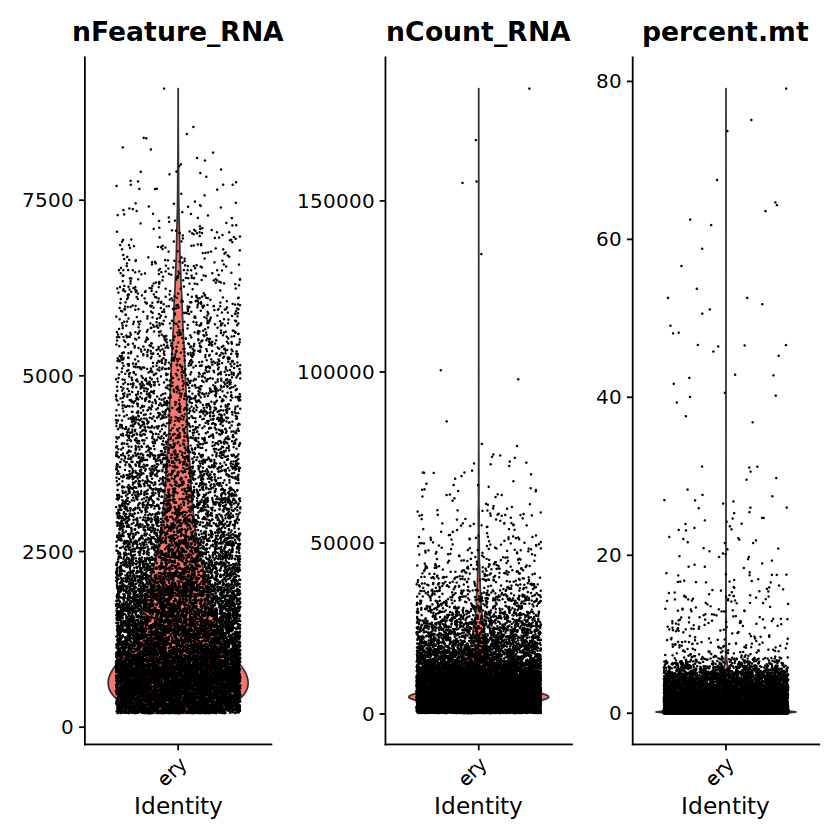

In [4]:
VlnPlot(ery, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

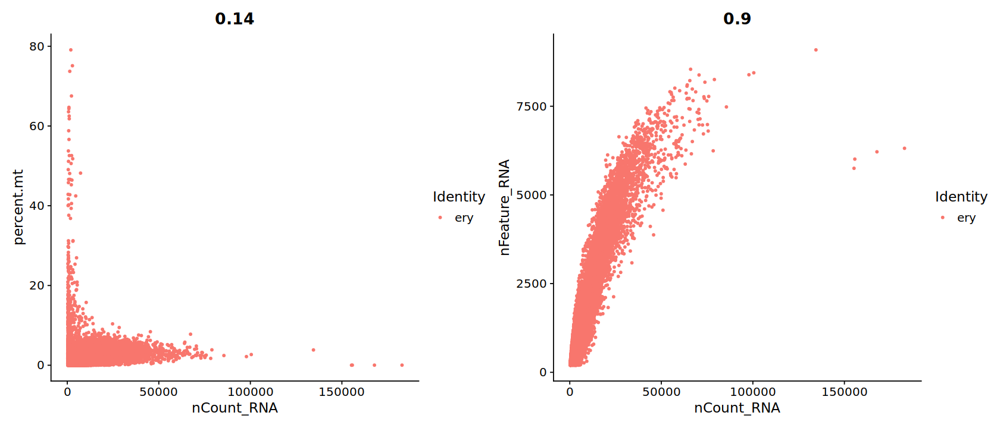

In [5]:
# FeatureScatter is typically used to visualize feature-feature relationships, but can be used
# for anything calculated by the object, i.e. columns in object metadata, PC scores etc.

options(repr.plot.width=14, repr.plot.height=6)
plot1 <- FeatureScatter(ery, feature1 = "nCount_RNA", feature2 = "percent.mt")
plot2 <- FeatureScatter(ery, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot1 + plot2

In [6]:
ery <- subset(ery, subset = nFeature_RNA < 7500 & percent.mt < 10)
ery

An object of class Seurat 
23676 features across 15061 samples within 1 assay 
Active assay: RNA (23676 features, 0 variable features)

In [26]:
write.csv(ery@meta.data, "230414_seurat_valid_cells.csv")

## Annotating cells by treatment

In [7]:
# cell classifications
classes = read.csv("230414_bd391_cell_classifications.csv")
colnames(classes) = c("bc", "sample")
classes$bc = sapply(classes$bc, function(x) paste(x, "-1", sep=''))
rownames(classes) = classes$bc
head(classes)

,bc,sample
,<chr>,<chr>
AAACCCAAGACAAGCC-1,AAACCCAAGACAAGCC-1,X10
AAACCCAAGACATCCT-1,AAACCCAAGACATCCT-1,X11
AAACCCAAGAGCATTA-1,AAACCCAAGAGCATTA-1,X8
AAACCCAAGCCGGAAT-1,AAACCCAAGCCGGAAT-1,X2
AAACCCACAACAACAA-1,AAACCCACAACAACAA-1,X7
AAACCCACAACCAACT-1,AAACCCACAACCAACT-1,X0


In [8]:
# rename
classes[classes["sample"] == "X0",]$sample = "donor800_11_dmso"
classes[classes["sample"] == "X1",]$sample = "donor800_11_hu"
classes[classes["sample"] == "X2",]$sample = "donor800_11_aph"
classes[classes["sample"] == "X3",]$sample = "donor804_11_dmso"
classes[classes["sample"] == "X4",]$sample = "donor804_11_hu"
classes[classes["sample"] == "X5",]$sample = "donor804_11_aph"
classes[classes["sample"] == "X6",]$sample = "donor800_14_dmso"
classes[classes["sample"] == "X7",]$sample = "donor800_14_hu"
classes[classes["sample"] == "X8",]$sample = "donor800_14_aph"
classes[classes["sample"] == "X9",]$sample = "donor804_14_dmso"
classes[classes["sample"] == "X10",]$sample = "donor804_14_hu"
classes[classes["sample"] == "X11",]$sample = "donor804_14_aph"

In [9]:
ery@meta.data$sample = classes[rownames(ery@meta.data),]$sample
head(ery@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample
,<fct>,<dbl>,<int>,<dbl>,<chr>
AAACCCAAGACAAGCC-1,ery,5013,1164,0.03989627,donor804_14_hu
AAACCCAAGACATCCT-1,ery,697,287,0.28694405,donor804_14_aph
AAACCCAAGAGCATTA-1,ery,4929,766,0.20288091,donor800_14_aph
AAACCCAAGCCGGAAT-1,ery,20163,3018,0.89272430,donor800_11_aph
AAACCCACAACAACAA-1,ery,4964,621,0.06043513,donor800_14_hu
AAACCCACAACCAACT-1,ery,1532,555,0.00000000,donor800_11_dmso


In [10]:
ery <- subset(ery, subset = (sample != "Doublet"))
ery <- subset(ery, subset = (sample != "Negative"))
ery

An object of class Seurat 
23676 features across 12574 samples within 1 assay 
Active assay: RNA (23676 features, 0 variable features)

In [11]:
ery <- NormalizeData(ery)

In [12]:
ery <- FindVariableFeatures(ery, selection.method = "vst", nfeatures = 2000)

# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(ery), 10)

# plot variable features with and without labels
options(repr.plot.width=18, repr.plot.height=12)

plot1 <- VariableFeaturePlot(ery)
plot2 <- LabelPoints(plot = plot1, points = top10, repel = TRUE)
plot1 + plot2

When using repel, set xnudge and ynudge to 0 for optimal results

Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Transformation introduced infinite values in continuous x-axis”
ERROR while rich displaying an object: Error: The viewport may be too small to show this patchwork.
 Please make it larger.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::m

In [17]:
all.genes <- rownames(ery)
ery <- ScaleData(ery, features = all.genes)

Centering and scaling data matrix



PC_ 1 
Positive:  IFIT1B, TMCC2, RSAD2, S100A10, HMOX1, CLEC2B, AC092490.1, C5, KRT1, PCSK1N 
	   IFI27, AC024267.1, IFIT2, PCSK6, IFIT3, AC011287.1, TRIB3, SPINK4, PBX1, ITLN1 
	   ABLIM1, IFIT1, CA1, BIRC3, C3orf84, EBF1, ELF3, ISG15, C5orf47, EDIL3 
Negative:  RPL10A, RPL3, RPL23, NPM1, LDHB, EEF1B2, RPS18, RPL17, RPL36, RPL5 
	   RPS2, RPL10, RPLP0, RPS23, RPL37A, GAPDH, NME2, PPIA, S100A4, RPS5 
	   SNHG29, RPL13, RPSA, RACK1, RPS17, HSPD1, NASP, RPL35, RPS9, RPS4X 
PC_ 2 
Positive:  ATP5IF1, HES6, TUBA1B, HIST1H4C, TUBB, TMEM14C, HMGB1, RPL8, APOC1, MAP2K2 
	   CCNB2, PCLAF, LMNA, LINC01133, RPS16, RPS5, TUBB4B, RPL35, MCM7, RPSA 
	   RPL14, RANBP1, TMEM14B, HIST1H1B, METAP2, RPLP0, RPS21, RPS3, NME4, RPL29 
Negative:  CELF2, LRMDA, XYLT1, ETV6, VIM, FNBP1, DOCK2, UTRN, P2RY8, CYBA 
	   ATP8B4, AIF1, PKM, FLI1, PRSS57, ANXA1, SEPTIN6, TRIO, DOCK10, PLXDC2 
	   CD74, AKT3, LPCAT2, KCNQ5, ELMO1, VAV3, MSRB3, FNDC3B, RNF130, ZNF521 
PC_ 3 
Positive:  RABGAP1L, NFIA, DIAPH3, RGS6, SL

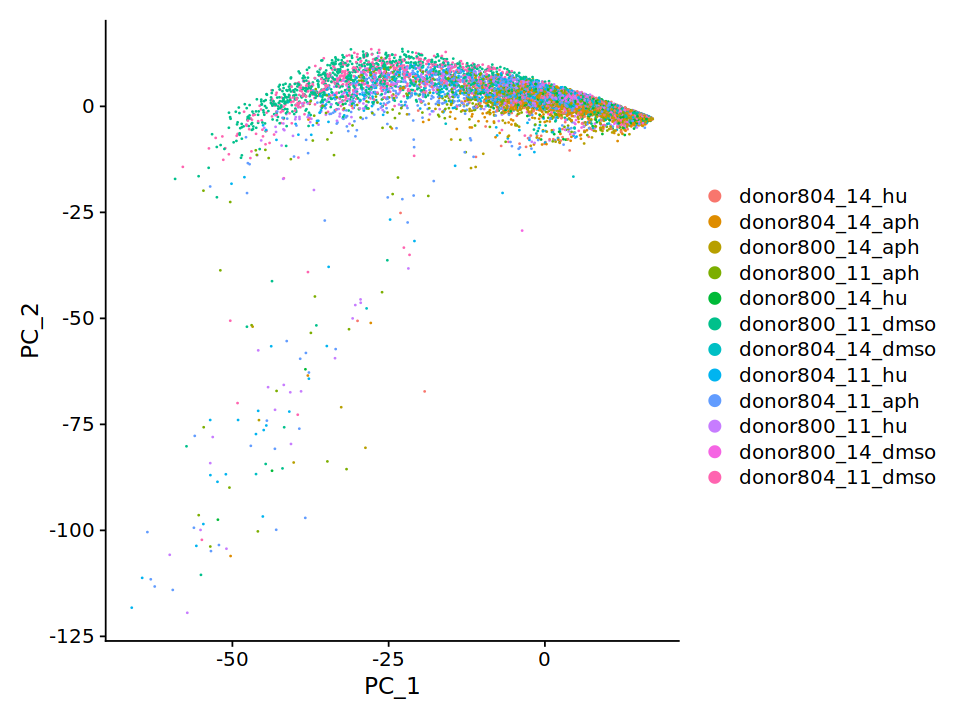

In [100]:
options(repr.plot.width=8, repr.plot.height=6)
ery <- RunPCA(ery, features = VariableFeatures(object = ery))
DimPlot(ery, reduction = "pca")

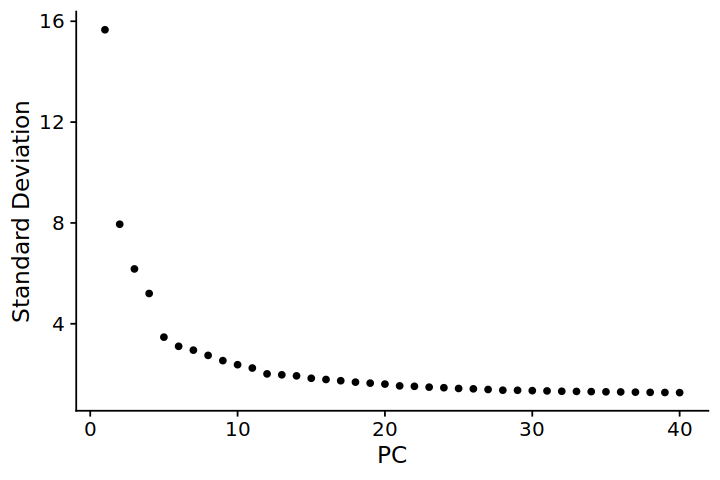

In [101]:
options(repr.plot.width=6, repr.plot.height=4)
    ElbowPlot(object = ery, ndims = 40)

In [3]:
ery <- FindNeighbors(ery, dims = 1:11)
ery <- FindClusters(ery, resolution = 0.5)
ery <- RunUMAP(ery, dims=1:11)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 12574
Number of edges: 399693

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8802
Number of communities: 11
Elapsed time: 2 seconds


Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
00:09:13 UMAP embedding parameters a = 0.9922 b = 1.112

00:09:13 Read 12574 rows and found 11 numeric columns

00:09:13 Using Annoy for neighbor search, n_neighbors = 30

00:09:13 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

00:09:16 Writing NN index file to temp file /tmp/RtmpsqZXxQ/file7f00266331f6

00:09:16 Searching Annoy index using 1 thread, search_k = 3000

00:09:22 Annoy recall = 100%

00:09:22 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors 

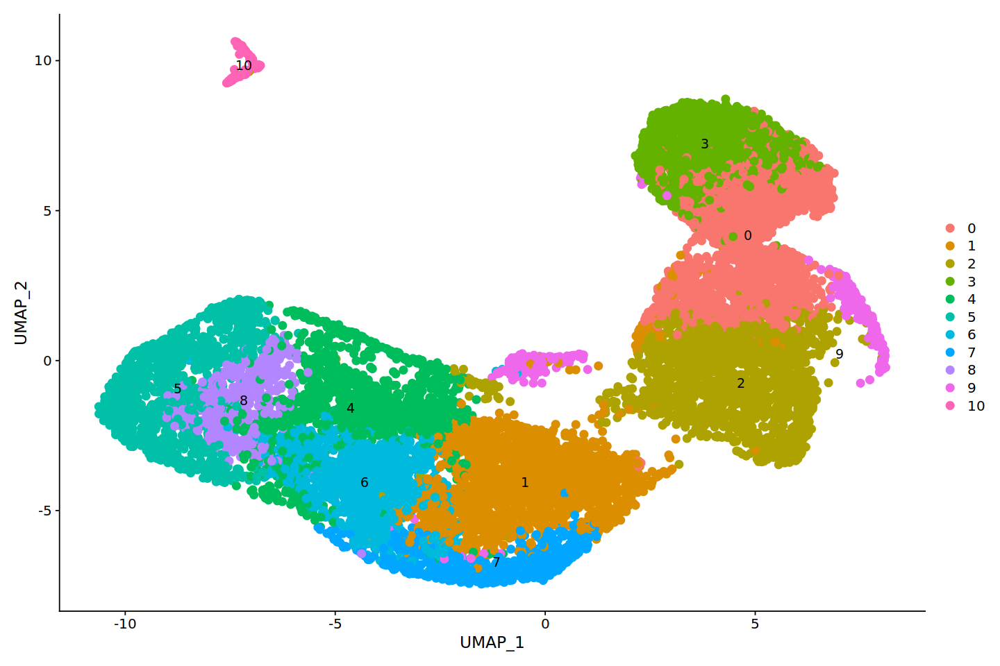

In [6]:
options(repr.plot.width=12, repr.plot.height=8)
DimPlot(ery, reduction = "umap", pt.size=3, label=T)

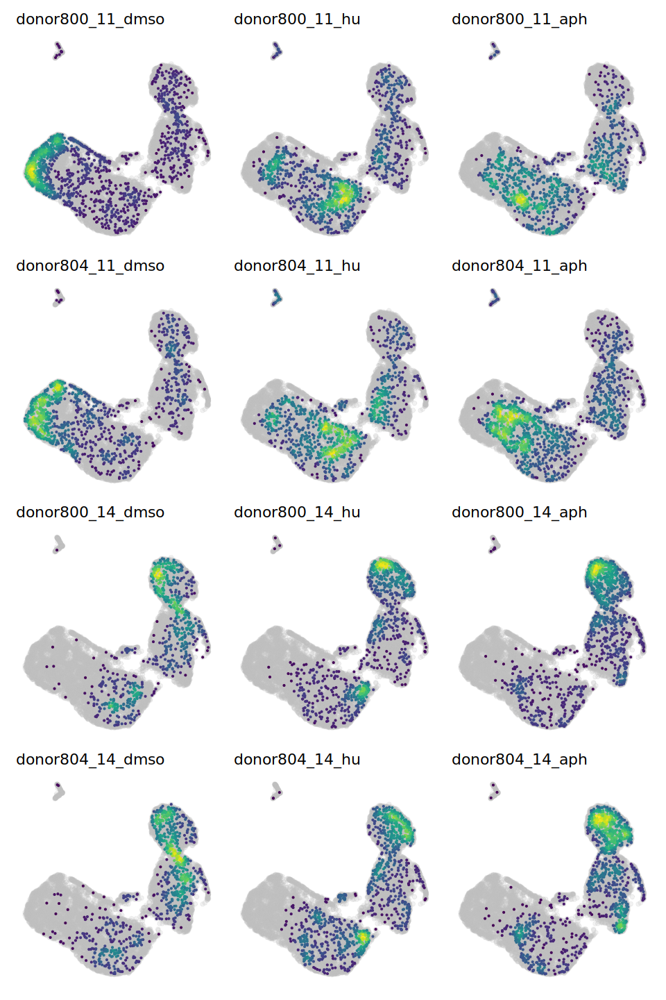

In [21]:
umap_df = as.data.frame(Embeddings(ery, reduction="umap"))
g = ggplot(data=umap_df, aes(x=UMAP_1, y=UMAP_2)) + geom_point(alpha=0.2, color="gray")

samples = c("donor800_11_dmso", "donor800_11_hu", "donor800_11_aph",
            "donor804_11_dmso", "donor804_11_hu", "donor804_11_aph",
            "donor800_14_dmso", "donor800_14_hu", "donor800_14_aph",
            "donor804_14_dmso", "donor804_14_hu", "donor804_14_aph")

plot_list = list()
for (s in samples) {
    umap_ss = umap_df[rownames(subset(ery@meta.data, sample == s)),]
    plot_list[[s]] = g + geom_pointdensity(data=umap_ss, size=0.5, adjust=1) + 
                  umap_theme + NoLegend() + ggtitle(s) + scale_color_viridis()
}

options(repr.plot.width=8, repr.plot.height=12)
wrap_plots(plot_list, ncol=3)

Warning message:
“CombinePlots is being deprecated. Plots should now be combined using the patchwork system.”


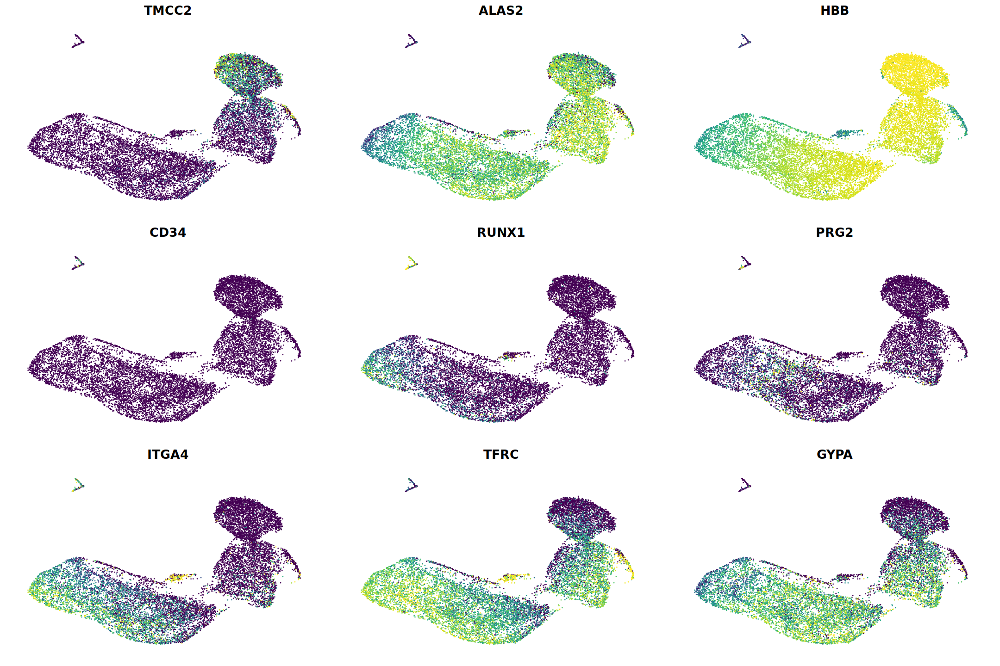

In [127]:
options(repr.plot.width=18, repr.plot.height=12)

genes = c("TMCC2", "ALAS2", "HBB", "CD34", "RUNX1", "PRG2", "ITGA4", "TFRC", "GYPA")
plot_list <- FeaturePlot(
  ery,
  features=unlist(genes),
  combine=FALSE, cols=viridis(256),
  max.cutoff='q95'
)

# apply theme to each feature plot
for(i in 1:length(plot_list)){
  plot_list[[i]] <- plot_list[[i]] + umap_theme + NoLegend()
}

CombinePlots(plot_list)

Warning message:
“CombinePlots is being deprecated. Plots should now be combined using the patchwork system.”


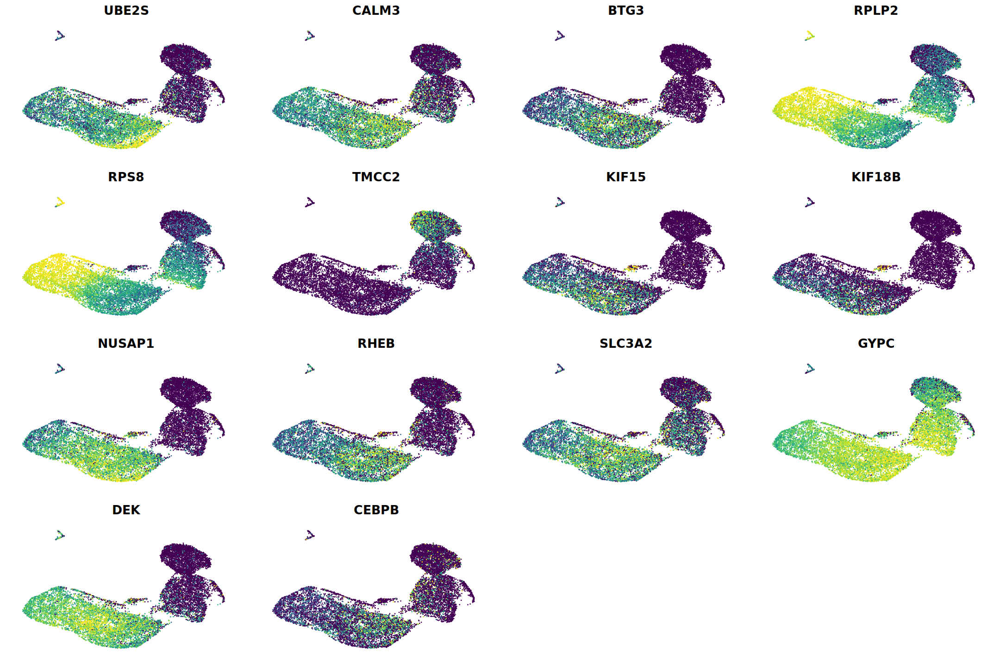

In [164]:
options(repr.plot.width=18, repr.plot.height=12)
genes = c("UBE2S", "CALM3", "BTG3", "RPLP2", "RPS8", "TMCC2",
          "KIF15", "KIF18B", "NUSAP1", "RHEB", "SLC3A2", "GYPC", "DEK", "CEBPB")
plot_list <- FeaturePlot(
  ery,
  features=unlist(genes),
  combine=FALSE, cols=viridis(256),
  max.cutoff='q95'
)

# apply theme to each feature plot
for(i in 1:length(plot_list)){
  plot_list[[i]] <- plot_list[[i]] + umap_theme + NoLegend()
}

CombinePlots(plot_list)

In [20]:
saveRDS(ery, "230424_ery_seurat.rds")

In [2]:
ery = readRDS("230424_ery_seurat.rds")

## Batch correction with seurat

In [52]:
ery@meta.data$donor = sapply(ery@meta.data$sample, function(x) strsplit(x, "_")[[1]][1])
head(ery@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample,RNA_snn_res.0.5,seurat_clusters,donor
,<fct>,<dbl>,<int>,<dbl>,<chr>,<fct>,<fct>,<chr>
AAACCCAAGACAAGCC-1,ery,5013,1164,0.03989627,donor804_14_hu,7,7,donor804
AAACCCAAGACATCCT-1,ery,697,287,0.28694405,donor804_14_aph,0,0,donor804
AAACCCAAGAGCATTA-1,ery,4929,766,0.20288091,donor800_14_aph,0,0,donor800
AAACCCAAGCCGGAAT-1,ery,20163,3018,0.89272430,donor800_11_aph,4,4,donor800
AAACCCACAACAACAA-1,ery,4964,621,0.06043513,donor800_14_hu,0,0,donor800
AAACCCACAACCAACT-1,ery,1532,555,0.00000000,donor800_11_dmso,4,4,donor800


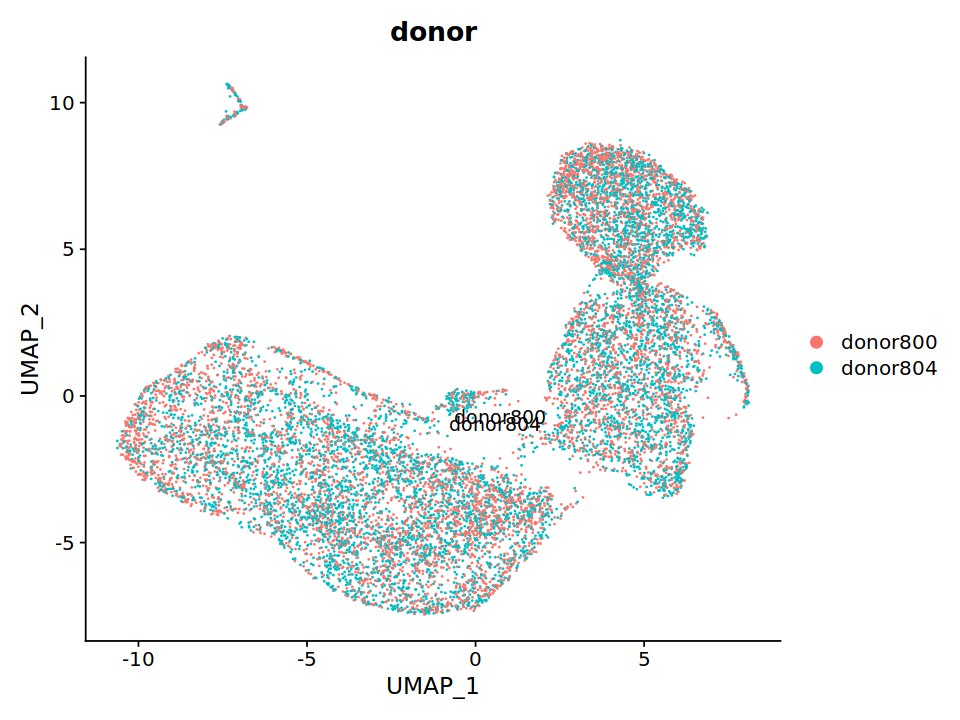

In [56]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(ery, reduction = "umap", label=T, group.by="donor")

In [53]:
# from https://satijalab.org/seurat/articles/integration_introduction.html
# split the dataset into a list of two seurat objects (stim and CTRL)
ery.list <- SplitObject(ery, split.by = "donor")

# normalize and identify variable features for each dataset independently
ery.list <- lapply(X = ery.list, FUN = function(x) {
    x <- NormalizeData(x)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 2000)
})

# select features that are repeatedly variable across datasets for integration
features <- SelectIntegrationFeatures(object.list = ery.list)

In [54]:
ery.anchors <- FindIntegrationAnchors(object.list = ery.list, anchor.features = features)

# this command creates an 'integrated' data assay
ery.combined <- IntegrateData(anchorset = ery.anchors)

Scaling features for provided objects

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 16277 anchors

Filtering anchors

	Retained 11224 anchors

Merging dataset 2 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [59]:
DefaultAssay(ery.combined) <- "integrated"

# Run the standard workflow for visualization and clustering
ery.combined <- ScaleData(ery.combined, verbose = FALSE)
ery.combined <- RunPCA(ery.combined, npcs = 30, verbose = FALSE)
ery.combined <- RunUMAP(ery.combined, reduction = "pca", dims = 1:11)
ery.combined <- FindNeighbors(ery.combined, reduction = "pca", dims = 1:11)
ery.combined <- FindClusters(ery.combined, resolution = 0.5)

13:46:58 UMAP embedding parameters a = 0.9922 b = 1.112

13:46:58 Read 12574 rows and found 11 numeric columns

13:46:58 Using Annoy for neighbor search, n_neighbors = 30

13:46:58 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:47:01 Writing NN index file to temp file /tmp/RtmpsqZXxQ/file7f006e61c3a0

13:47:01 Searching Annoy index using 1 thread, search_k = 3000

13:47:07 Annoy recall = 100%

13:47:07 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:47:10 Initializing from normalized Laplacian + noise (using irlba)

13:47:10 Commencing optimization for 200 epochs, with 505412 positive edges

13:47:31 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 12574
Number of edges: 404555

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8840
Number of communities: 11
Elapsed time: 2 seconds


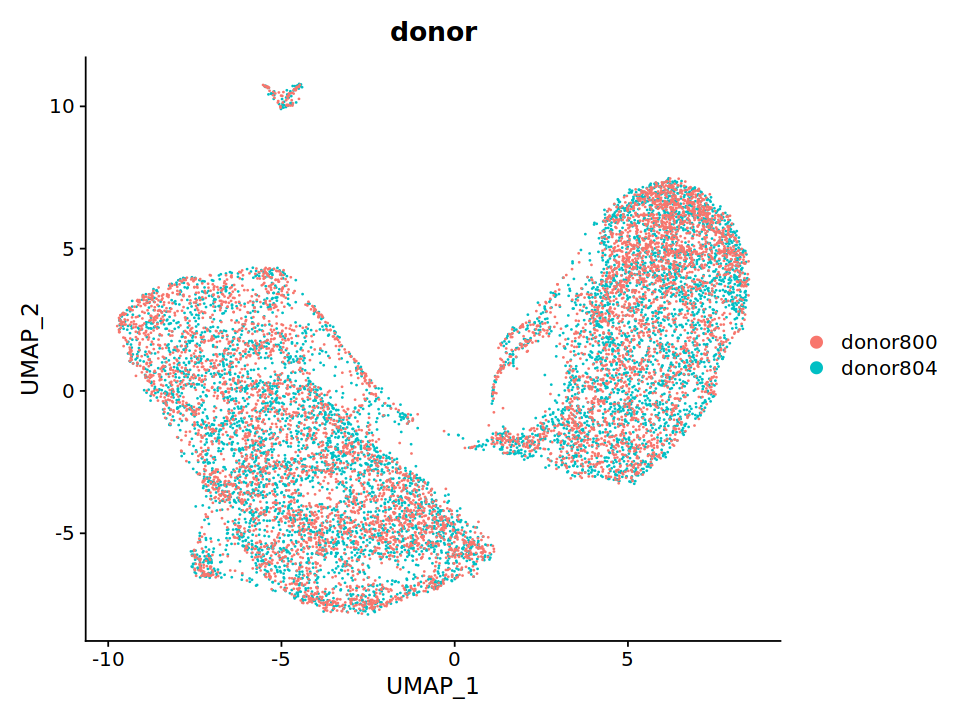

In [60]:
DimPlot(ery.combined, reduction = "umap", group.by = "donor")

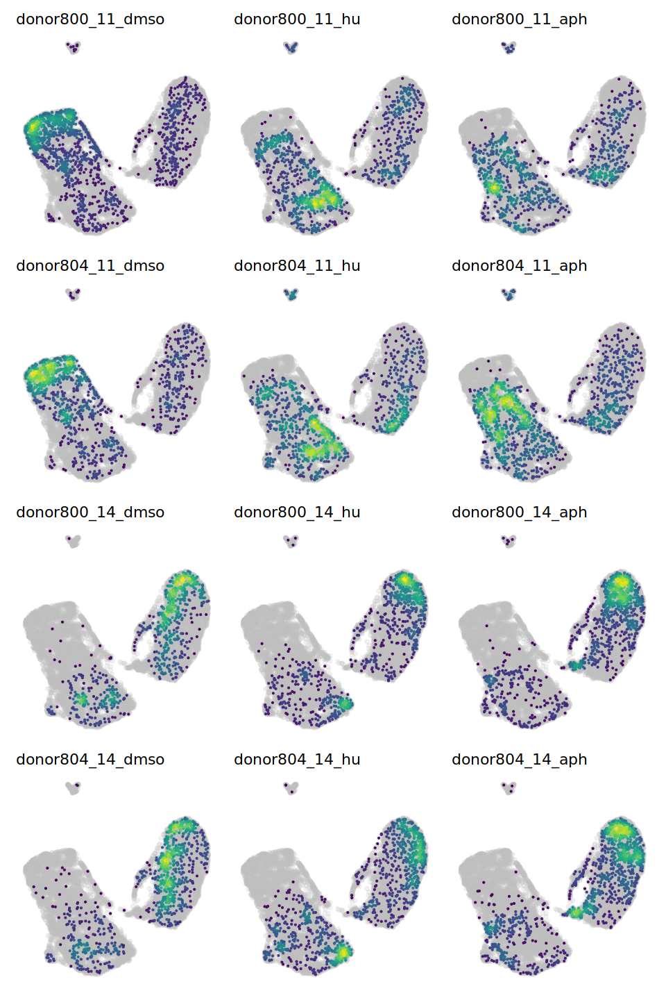

In [62]:
umap_df = as.data.frame(Embeddings(ery.combined, reduction="umap"))
g = ggplot(data=umap_df, aes(x=UMAP_1, y=UMAP_2)) + geom_point(alpha=0.2, color="gray")

samples = c("donor800_11_dmso", "donor800_11_hu", "donor800_11_aph",
            "donor804_11_dmso", "donor804_11_hu", "donor804_11_aph",
            "donor800_14_dmso", "donor800_14_hu", "donor800_14_aph",
            "donor804_14_dmso", "donor804_14_hu", "donor804_14_aph")

plot_list = list()
for (s in samples) {
    umap_ss = umap_df[rownames(subset(ery.combined@meta.data, sample == s)),]
    plot_list[[s]] = g + geom_pointdensity(data=umap_ss, size=0.5, adjust=1) + 
                  umap_theme + NoLegend() + ggtitle(s) + scale_color_viridis()
}

options(repr.plot.width=8, repr.plot.height=12)
wrap_plots(plot_list, ncol=3)

## Troubleshooting clusters 

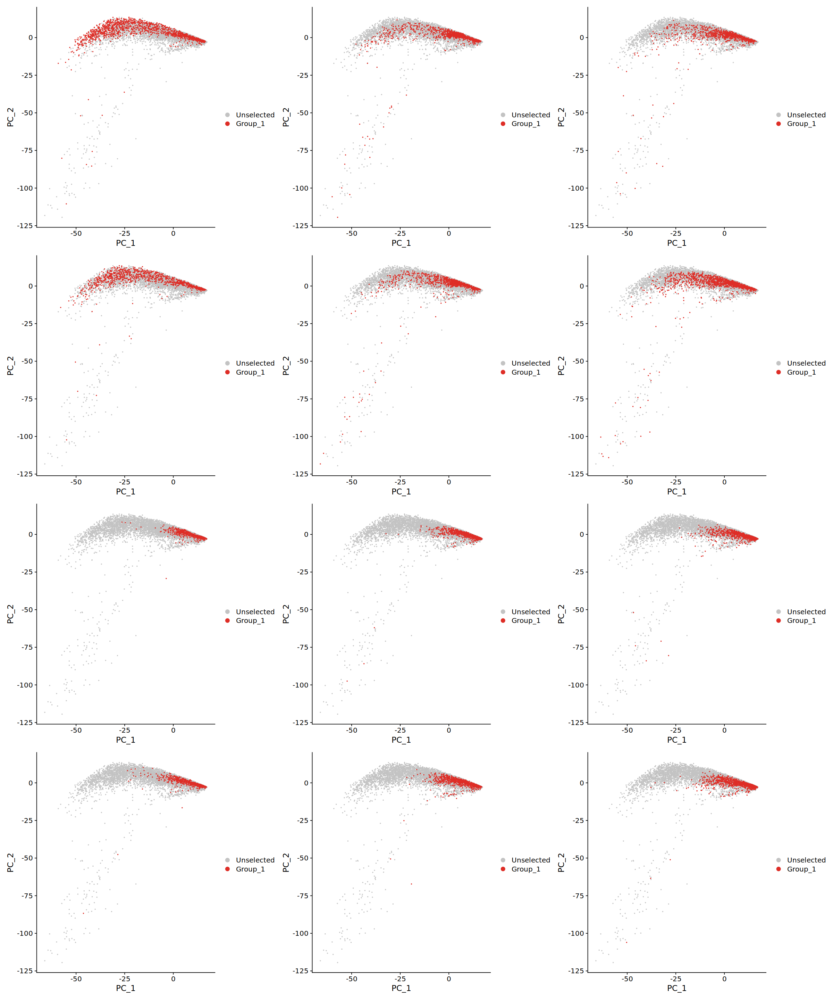

In [128]:
options(repr.plot.width=20, repr.plot.height=24)
p1 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor800_11_dmso"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p2 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor800_11_hu"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p3 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor800_11_aph"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p4 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor804_11_dmso"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p5 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor804_11_hu"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p6 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor804_11_aph"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p7 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor800_14_dmso"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p8 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor800_14_hu"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p9 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor800_14_aph"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p10 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor804_14_dmso"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p11 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor804_14_hu"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
p12 = DimPlot(ery, reduction = "pca", cells.highlight = WhichCells(object=ery, ident = "donor804_14_aph"), 
        pt.size=0.3, sizes.highlight=0.3) + plot_annotation(title="donor800_11_dmso")
(p1 + p2 + p3) / (p4 + p5 + p6) / (p7 + p8 + p9) / (p10 + p11 + p12)

In [29]:
counts_per_cell = read.csv("230414_bd391_multiseq_counts_per_cell.csv")
head(counts_per_cell)

,barcode,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,X11
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AAACCCAAGACAACTA,10,12,16,8,4,27,4,6,7,1,5,7
2,AAACCCAAGACAAGCC,7,14,17,20,6,40,3,9,11,17,112,8
3,AAACCCAAGACATCCT,8,9,23,16,8,29,5,15,10,15,5,249
4,AAACCCAAGACTGAGC,5,12,17,11,2,22,7,11,6,9,6,2
5,AAACCCAAGAGAGGTA,18,21,12,19,9,40,9,16,14,7,6,13
6,AAACCCAAGAGCATTA,7,13,18,6,6,29,10,15,106,8,5,10


In [66]:
counts_per_cell[counts_per_cell["barcode"] == "ATGGAGGGTTCGTAAC",]

,barcode,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,X11
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
17627,ATGGAGGGTTCGTAAC,13,6,11,101,3,32,4,8,12,3,3,11


In [63]:
# make sure the cells correspond to the correct barcode
subset(ery@meta.data, sample == "donor804_11_dmso" & seurat_clusters == 0)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample,RNA_snn_res.0.5,seurat_clusters
,<fct>,<dbl>,<int>,<dbl>,<chr>,<fct>,<fct>
AACGAAAGTCGTTATG-1,ery,8316,1662,1.1303511,donor804_11_dmso,0,0
AACGTCAAGGTTCCAT-1,ery,6752,1542,0.5331754,donor804_11_dmso,0,0
AAGCGTTTCTAGACAC-1,ery,9177,1797,1.8415604,donor804_11_dmso,0,0
AAGTCGTTCCCGAAAT-1,ery,7353,1354,0.4079967,donor804_11_dmso,0,0
ACACTGAAGCGCGTTC-1,ery,9736,1378,0.1540674,donor804_11_dmso,0,0
ACCGTTCGTAAGAACT-1,ery,6570,1149,0.0608828,donor804_11_dmso,0,0
ACTGATGGTGTGAGCA-1,ery,8073,1273,0.8670878,donor804_11_dmso,0,0
ACTTCGCAGAGGCGGA-1,ery,10009,2057,2.1980218,donor804_11_dmso,0,0
ACTTTGTAGCCATTCA-1,ery,5400,1235,0.2037037,donor804_11_dmso,0,0


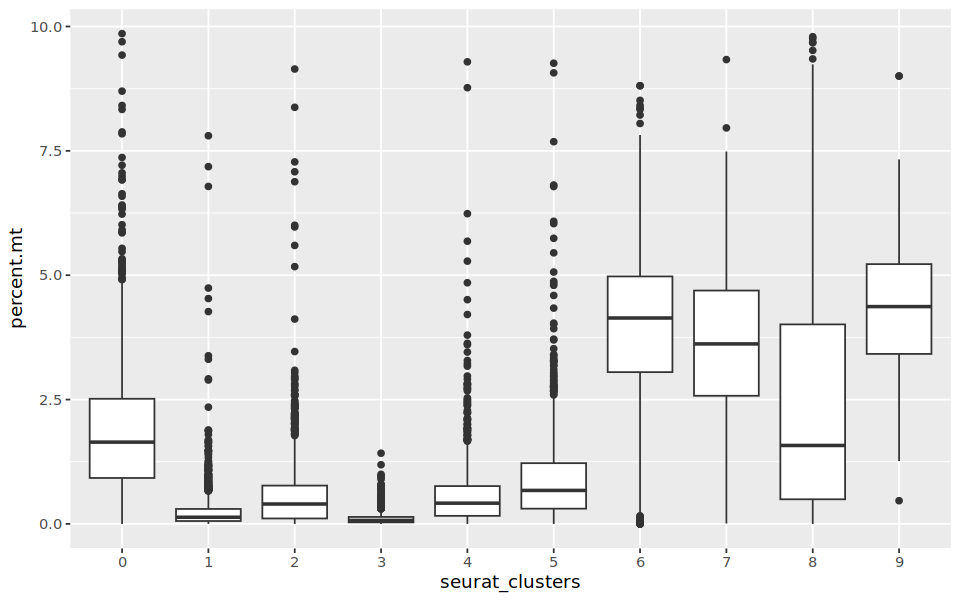

In [96]:
options(repr.plot.width=8, repr.plot.height=5)
ggplot(ery@meta.data, aes(x=seurat_clusters, y=percent.mt)) + geom_boxplot()

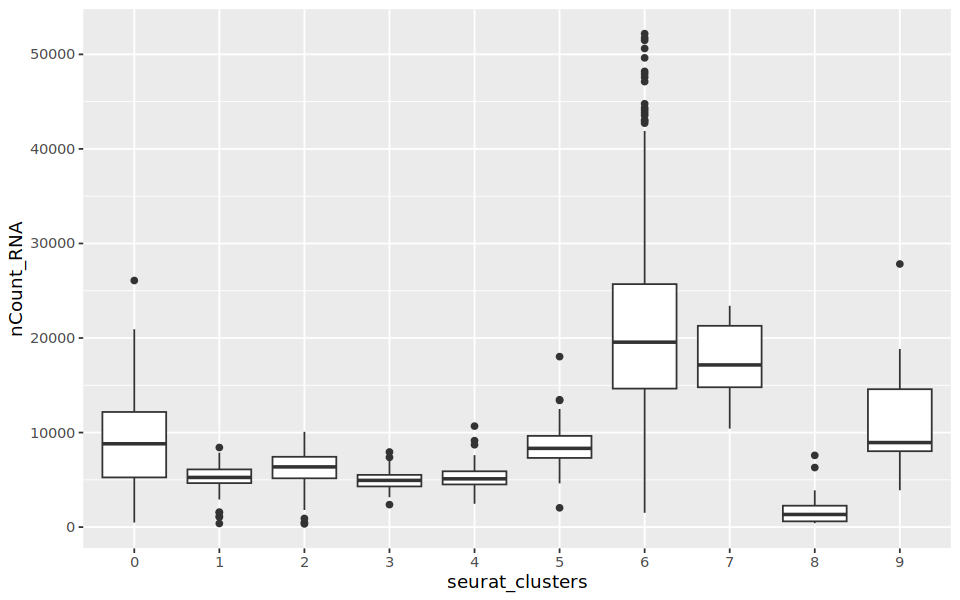

In [97]:
options(repr.plot.width=8, repr.plot.height=5)
ggplot(subset(ery@meta.data, sample == "donor800_11_dmso"), aes(x=seurat_clusters, y=nCount_RNA)) + geom_boxplot()

# Diff expr 

In [119]:
Idents(object = ery) <- "sample"
FeaturePlot(subset(ery, WhichCells(object=ery, ident = "donor800_11_hu")), features = c("UBE2S", "CALM3", "BTG3", "RPLP2", "RPS8", "TMCC2"),
        pt.size=3)

In [112]:
Idents(object = ery) <- "seurat_clusters"
markers <- FindMarkers(object = ery, ident.1 = "0")

In [116]:
Idents(object = ery) <- "seurat_clusters"
markers5 <- FindMarkers(object = ery, ident.1 = "5")

In [129]:
write.csv(markers, "230414_cluster0_markers.csv")

In [122]:
markers5

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NOC2L,0,0.3920804,0.537,0.059,0
AURKAIP1,0,0.8548884,0.959,0.418,0
MRPL20,0,0.9645880,0.955,0.337,0
ATAD3B,0,0.3219767,0.417,0.032,0
ATAD3A,0,0.4663043,0.576,0.069,0
PRXL2B,0,0.3504104,0.472,0.045,0
LRRC47,0,0.2887749,0.431,0.055,0
RPL22,0,1.5571110,1.000,0.666,0
DNAJC11,0,0.4264294,0.574,0.075,0


# Compare to normal

In [66]:
ery@meta.data$tx = sapply(ery@meta.data$sample, function(x) strsplit(x, "_")[[1]][3])
ery@meta.data$tx
head(ery@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample,RNA_snn_res.0.5,seurat_clusters,donor,tx
,<fct>,<dbl>,<int>,<dbl>,<chr>,<fct>,<fct>,<chr>,<chr>
AAACCCAAGACAAGCC-1,ery,5013,1164,0.03989627,donor804_14_hu,7,7,donor804,hu
AAACCCAAGACATCCT-1,ery,697,287,0.28694405,donor804_14_aph,0,0,donor804,aph
AAACCCAAGAGCATTA-1,ery,4929,766,0.20288091,donor800_14_aph,0,0,donor800,aph
AAACCCAAGCCGGAAT-1,ery,20163,3018,0.89272430,donor800_11_aph,4,4,donor800,aph
AAACCCACAACAACAA-1,ery,4964,621,0.06043513,donor800_14_hu,0,0,donor800,hu
AAACCCACAACCAACT-1,ery,1532,555,0.00000000,donor800_11_dmso,4,4,donor800,dmso


In [67]:
# from https://satijalab.org/seurat/articles/integration_introduction.html
# split the dataset into a list of two seurat objects (stim and CTRL)
ery.tx.list <- SplitObject(ery, split.by = "tx")

# normalize and identify variable features for each dataset independently
ery.tx.list <- lapply(X = ery.tx.list, FUN = function(x) {
    x <- NormalizeData(x)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 2000)
})

# select features that are repeatedly variable across datasets for integration
features <- SelectIntegrationFeatures(object.list = ery.tx.list)

In [104]:
aph <- ery.tx.list[["aph"]]
hu <- ery.tx.list[["hu"]]
dmso <- ery.tx.list[["dmso"]]

dmso <- RunUMAP(dmso, dims = 1:30, reduction = "pca", return.model = TRUE)

dmso_hu_anchors <- FindTransferAnchors(reference = dmso, query = hu,
    dims = 1:30, reference.reduction = "pca")
dmso_aph_anchors <- FindTransferAnchors(reference = dmso, query = aph,
    dims = 1:30, reference.reduction = "pca")

hu <- MapQuery(anchorset = dmso_hu_anchors, reference = dmso, query = hu,
    reference.reduction = "pca", reduction.model = "umap")
aph <- MapQuery(anchorset = dmso_aph_anchors, reference = dmso, query = aph,
    reference.reduction = "pca", reduction.model = "umap")

UMAP will return its model

14:18:47 UMAP embedding parameters a = 0.9922 b = 1.112

14:18:47 Read 4156 rows and found 30 numeric columns

14:18:47 Using Annoy for neighbor search, n_neighbors = 30

14:18:47 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:18:48 Writing NN index file to temp file /tmp/RtmpsqZXxQ/file7f0061e41b62

14:18:48 Searching Annoy index using 1 thread, search_k = 3000

14:18:50 Annoy recall = 100%

14:18:50 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:18:52 Initializing from normalized Laplacian + noise (using irlba)

14:18:52 Commencing optimization for 500 epochs, with 177442 positive edges

14:19:10 Optimization finished

Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Foun

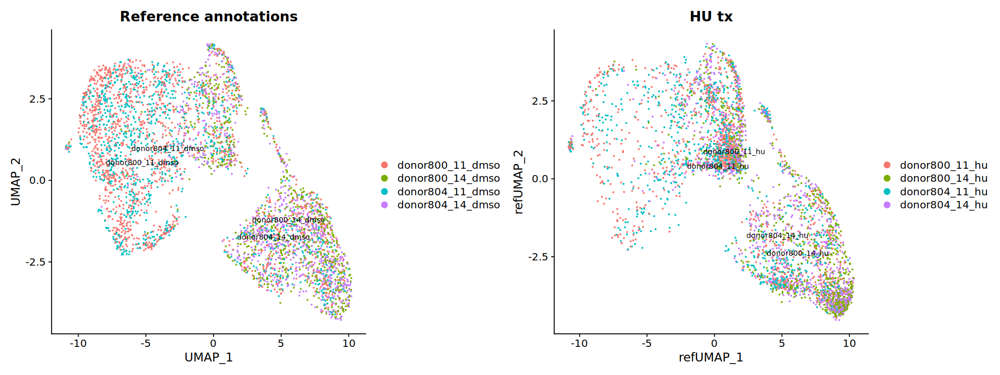

In [80]:
options(repr.plot.width=16, repr.plot.height=6)
p1 <- DimPlot(dmso, reduction = "umap", group.by = "sample", label = TRUE, label.size = 3,
    repel = TRUE) + ggtitle("Reference annotations")
p2 <- DimPlot(hu, reduction = "ref.umap", group.by = "sample", label = TRUE,
    label.size = 3, repel = TRUE) + ggtitle("HU tx")
p1 + p2

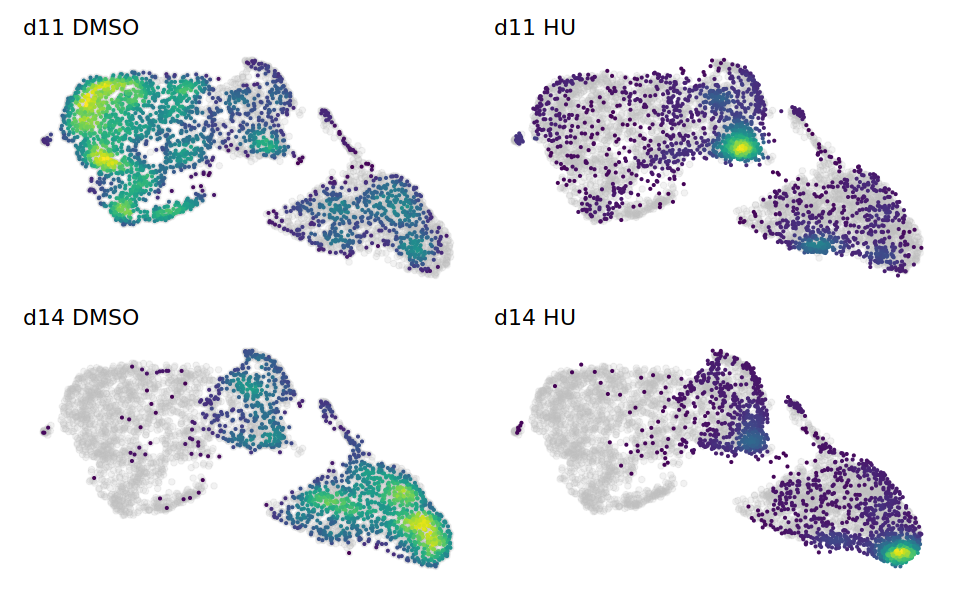

In [110]:
options(repr.plot.width=8, repr.plot.height=5)
umap_df = as.data.frame(Embeddings(dmso, reduction="umap"))
umap_hu_df = as.data.frame(Embeddings(hu, reduction="ref.umap"))

umap_ss = umap_df[rownames(subset(ery.combined@meta.data, 
                                  sample == "donor800_11_dmso" | sample == "donor804_11_dmso")),]

umap_hu_ss = umap_hu_df[rownames(subset(ery.combined@meta.data, 
                                        sample == "donor800_11_hu" | sample == "donor804_11_hu" )),]

g = ggplot(data=umap_df, aes(x=UMAP_1, y=UMAP_2)) + geom_point(alpha=0.2, color="gray")
p1 = g + geom_pointdensity(data=umap_ss, aes(x=UMAP_1, y=UMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d11 DMSO") + scale_color_viridis()
p2 = g + geom_pointdensity(data=umap_hu_ss, aes(x=refUMAP_1, y=refUMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d11 HU") + scale_color_viridis()


umap_ss = umap_df[rownames(subset(ery.combined@meta.data, 
                                  sample == "donor800_14_dmso" | sample == "donor804_14_dmso")),]
umap_hu_ss = umap_hu_df[rownames(subset(ery.combined@meta.data, 
                                        sample == "donor800_14_hu" |  sample == "donor804_14_hu")),]

g = ggplot(data=umap_df, aes(x=UMAP_1, y=UMAP_2)) + geom_point(alpha=0.2, color="gray")
p3 = g + geom_pointdensity(data=umap_ss, aes(x=UMAP_1, y=UMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d14 DMSO") + scale_color_viridis()
p4 = g + geom_pointdensity(data=umap_hu_ss, aes(x=refUMAP_1, y=refUMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d14 HU") + scale_color_viridis()

(p1+p2)/(p3+p4)

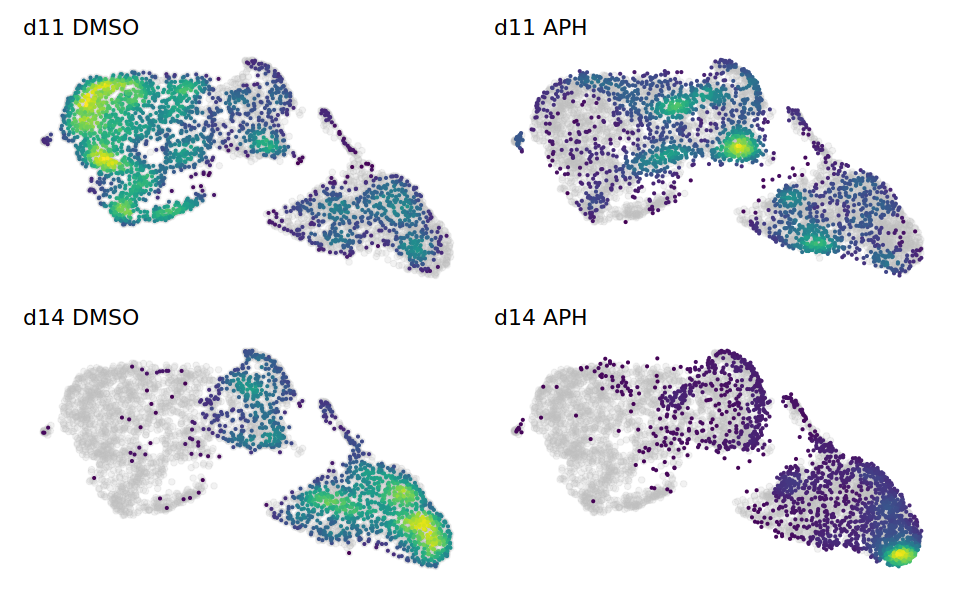

In [109]:
options(repr.plot.width=8, repr.plot.height=5)
umap_df = as.data.frame(Embeddings(dmso, reduction="umap"))
umap_aph_df = as.data.frame(Embeddings(aph, reduction="ref.umap"))

umap_ss = umap_df[rownames(subset(ery.combined@meta.data, 
                                  sample == "donor800_11_dmso" | sample == "donor804_11_dmso")),]

umap_aph_ss = umap_aph_df[rownames(subset(ery.combined@meta.data, 
                                        sample == "donor800_11_aph" | sample == "donor804_11_aph" )),]

g = ggplot(data=umap_df, aes(x=UMAP_1, y=UMAP_2)) + geom_point(alpha=0.2, color="gray")
p1 = g + geom_pointdensity(data=umap_ss, aes(x=UMAP_1, y=UMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d11 DMSO") + scale_color_viridis()
p2 = g + geom_pointdensity(data=umap_aph_ss, aes(x=refUMAP_1, y=refUMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d11 APH") + scale_color_viridis()


umap_ss = umap_df[rownames(subset(ery.combined@meta.data, 
                                  sample == "donor800_14_dmso" | sample == "donor804_14_dmso")),]
umap_aph_ss = umap_aph_df[rownames(subset(ery.combined@meta.data, 
                                        sample == "donor800_14_aph" |  sample == "donor804_14_aph")),]

g = ggplot(data=umap_df, aes(x=UMAP_1, y=UMAP_2)) + geom_point(alpha=0.2, color="gray")
p3 = g + geom_pointdensity(data=umap_ss, aes(x=UMAP_1, y=UMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d14 DMSO") + scale_color_viridis()
p4 = g + geom_pointdensity(data=umap_aph_ss, aes(x=refUMAP_1, y=refUMAP_2), size=0.5, adjust=1) + 
              umap_theme + NoLegend() + ggtitle("d14 APH") + scale_color_viridis()

(p1+p2)/(p3+p4)

In [ ]:
# https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM4558nnn/GSM4558616/suppl/GSM4558616_BM2_filtered_gene_bc_matrices.tar.gz
# https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM4558nnn/GSM4558617/suppl/GSM4558617_BM3_filtered_gene_bc_matrices.tar.gz
# https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM4558nnn/GSM4558618/suppl/GSM4558618_BM4_filtered_gene_bc_matrices.tar.gz

# Map to normal BM

In [111]:
# wget files 
wget https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM3305nnn/GSM3305366/suppl/GSM3305366_LinNegCD34PosCD164Pos.raw_counts.tsv.gz
wget https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM3305nnn/GSM3305367/suppl/GSM3305367_LinNegCD34NegCD164high.raw_counts.tsv.gz
wget https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM3305nnn/GSM3305368/suppl/GSM3305368_LinNegCD34lowCD164high.raw_counts.tsv.gz
wget https://ftp.ncbi.nlm.nih.gov/geo/samples/GSM3305nnn/GSM3305369/suppl/GSM3305369_LinNegCD34NegCD164low.raw_counts.tsv.gz


ERROR: Error in parse(text = x, srcfile = src): <text>:1:8: unexpected symbol
1: ! wget https
           ^


In [133]:
data1 <- read.table(file="klein_data/GSM3305366_LinNegCD34PosCD164Pos.raw_counts.tsv", header=1, row.names=1)
data2 <- read.table(file="klein_data/GSM3305367_LinNegCD34NegCD164high.raw_counts.tsv", header=1, row.names=1)
data3 <- read.table(file="klein_data/GSM3305368_LinNegCD34lowCD164high.raw_counts.tsv", header=1, row.names=1)
data4 <- read.table(file="klein_data/GSM3305369_LinNegCD34NegCD164low.raw_counts.tsv", header=1, row.names=1)

In [134]:
data1 <- CreateSeuratObject(counts = data1, min.cells = 3, min.genes = 200, project = "data1")
data2 <- CreateSeuratObject(counts = data2, min.cells = 3, min.genes = 200, project = "data2")
data3 <- CreateSeuratObject(counts = data3, min.cells = 3, min.genes = 200, project = "data3")
data4 <- CreateSeuratObject(counts = data4, min.cells = 3, min.genes = 200, project = "data4")

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


In [136]:
klein.combined <- merge(data1, y = c(data2, data3, data4), 
                        add.cell.ids = c("cd34pos_cd164pos","cd34neg_cd164hi", 
                                         "cd34lo_cd164hi","cd34neg_cd164lo"), 
                        project = "klein")
klein.combined

An object of class Seurat 
18361 features across 15401 samples within 1 assay 
Active assay: RNA (18361 features, 0 variable features)

In [148]:
z = rownames(data4@assays$RNA)
z[grepl("^MT\\.", z)]

[1] "MT.ATP6" "MT.ATP8" "MT.CO1"  "MT.CO2"  "MT.CO3"  "MT.CYB"  "MT.ND1" 
 [8] "MT.ND2"  "MT.ND3"  "MT.ND4"  "MT.ND4L" "MT.ND5"  "MT.ND6"

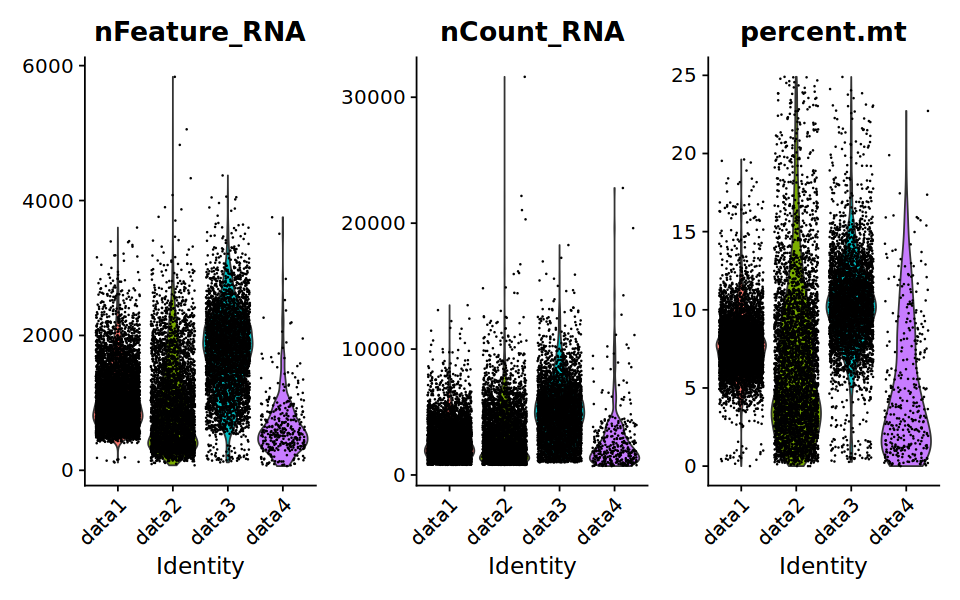

In [149]:
klein.combined[["percent.mt"]] <- PercentageFeatureSet(klein.combined, pattern = "^MT\\.")
VlnPlot(klein.combined, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

In [150]:
klein.combined <- subset(klein.combined, subset = nFeature_RNA < 4000 & percent.mt < 15)
klein.combined

An object of class Seurat 
18361 features across 14821 samples within 1 assay 
Active assay: RNA (18361 features, 0 variable features)

In [152]:
klein.combined <- NormalizeData(klein.combined)
klein.combined <- FindVariableFeatures(klein.combined, selection.method = "vst", nfeatures = 2000)
all.genes <- rownames(klein.combined)
klein.combined <- ScaleData(klein.combined, features = all.genes)

Centering and scaling data matrix



PC_ 1 
Positive:  ACTG1, TMSB4X, HLA.B, ENO1, GAPDH, CD74, SRGN, SERPINB1, PLAC8, PKM 
	   MPO, RNASE2, VIM, ARPC1B, LCP1, HLA.A, SELL, ARPC2, LYZ, MS4A3 
	   AZU1, PRSS57, ANXA1, ELANE, PRTN3, HLA.DRA, CTSG, CST7, XBP1, CORO1A 
Negative:  AHSP, HBB, HBD, CA1, HBA1, ALAS2, HBA2, BLVRB, SLC4A1, SLC25A37 
	   GYPA, ANK1, HBM, PRDX2, HMBS, TFRC, CA2, RHAG, HEMGN, GYPB 
	   FECH, CD36, SPTA1, SNCA, SLC25A39, EPB42, UROD, SLC2A1, KLF1, FAM210B 
PC_ 2 
Positive:  AZU1, ELANE, CTSG, RNASE2, PRTN3, RNASE3, CST7, MS4A3, LYZ, MPO 
	   CSTA, SRGN, RGCC, CEACAM6, DEFA4, FAM107B, MNDA, HBA2, CEBPD, SLC4A1 
	   SERPINB10, HBM, S100P, P4HB, RAB31, HBA1, CLEC11A, S100A11, CITED4, NKG7 
Negative:  ALDH1A1, CNRIP1, MARCKSL1, MYC, CYTL1, FAM178B, IL1B, SLC12A6, CD34, HDAC7 
	   FTH1, APOC1, REXO2, PDLIM1, TRIB2, CD52, CRHBP, ZFP36L1, GATA2, FAM89A 
	   FAM129B, S100A4, AKR1C3, KCNH2, CSF2RB, SPINK2, IFITM3, PCDH9, CBLL1, HOPX 
PC_ 3 
Positive:  FAM178B, S100A6, KCNH2, KIAA0101, HSPA8, ATPIF1, TUBA1B, HSP

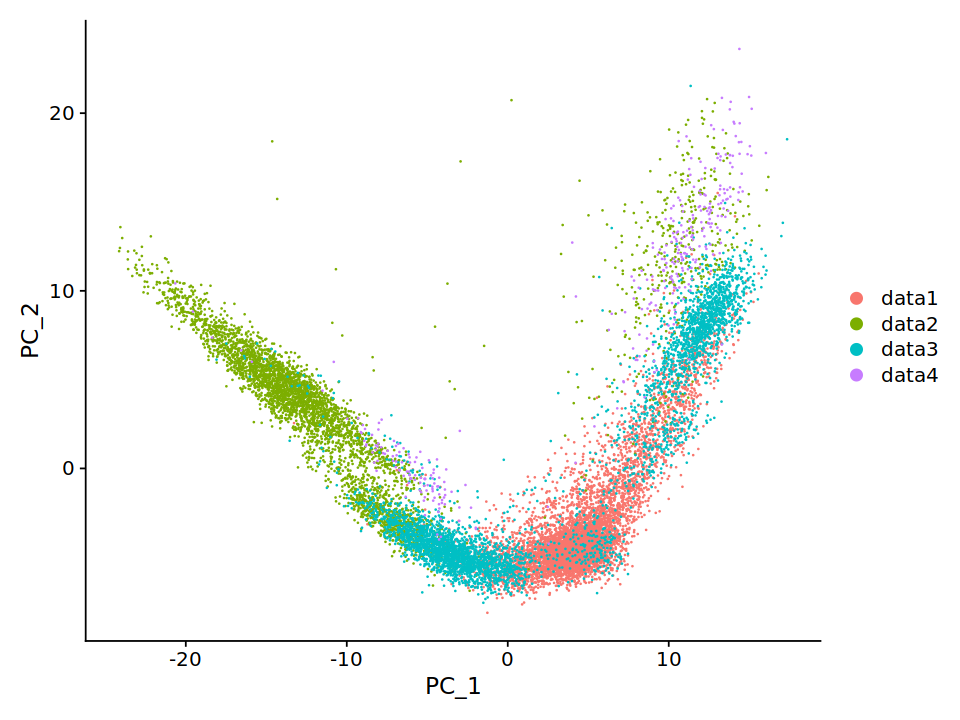

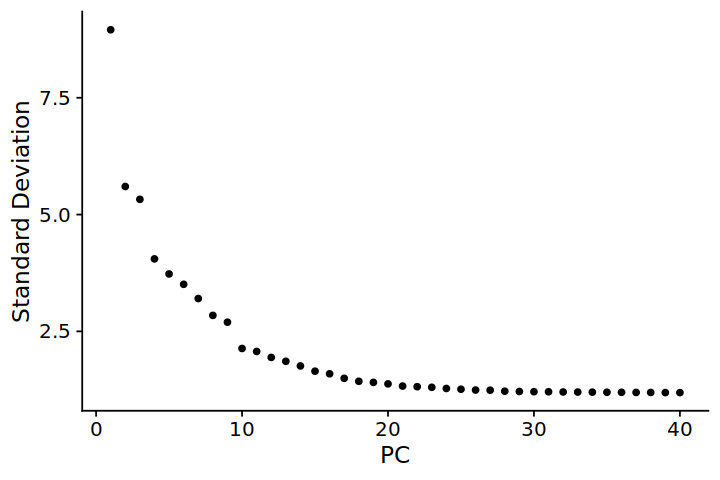

In [154]:
options(repr.plot.width=8, repr.plot.height=6)
klein.combined <- RunPCA(klein.combined, 
                         features = VariableFeatures(object = klein.combined))
DimPlot(klein.combined, reduction = "pca")

options(repr.plot.width=6, repr.plot.height=4)
    ElbowPlot(object = klein.combined, ndims = 40)

In [155]:
klein.combined <- FindNeighbors(klein.combined, dims = 1:20)
klein.combined <- FindClusters(klein.combined, resolution = 0.5)
klein.combined <- RunUMAP(klein.combined, dims=1:20)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14821
Number of edges: 544372

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9131
Number of communities: 14
Elapsed time: 4 seconds


15:28:35 UMAP embedding parameters a = 0.9922 b = 1.112

15:28:35 Read 14821 rows and found 20 numeric columns

15:28:35 Using Annoy for neighbor search, n_neighbors = 30

15:28:35 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:28:37 Writing NN index file to temp file /tmp/RtmpsqZXxQ/file7f0061d11f5

15:28:37 Searching Annoy index using 1 thread, search_k = 3000

15:28:43 Annoy recall = 100%

15:28:45 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

15:28:48 Initializing from normalized Laplacian + noise (using irlba)

15:28:49 Commencing optimization for 200 epochs, with 628144 positive edges

15:29:16 Optimization finished



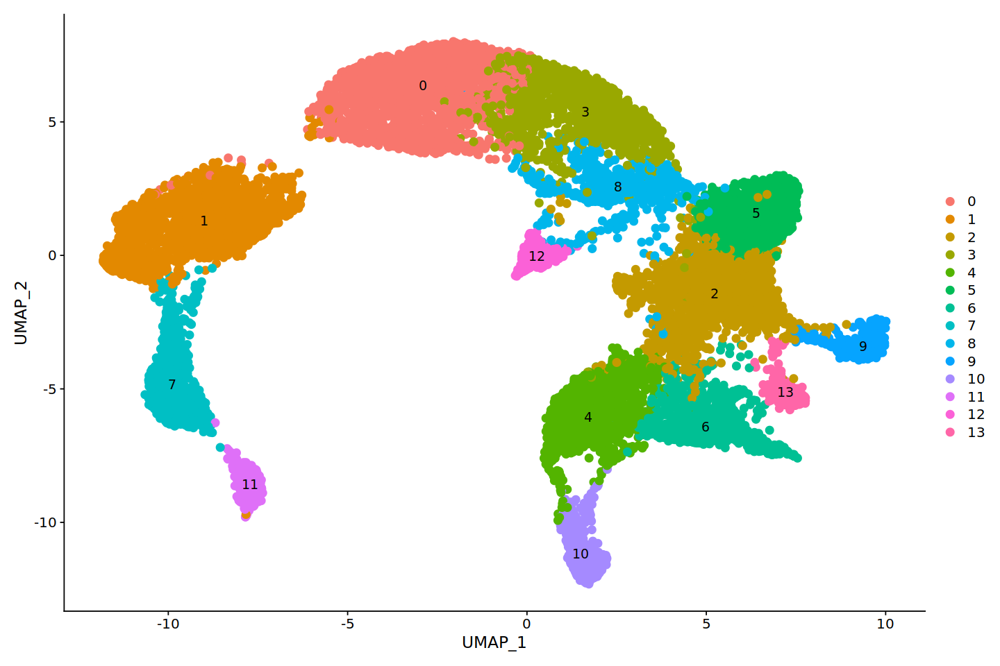

In [156]:
options(repr.plot.width=12, repr.plot.height=8)
DimPlot(klein.combined, reduction = "umap", pt.size=3, label=T)

Warning message:
“CombinePlots is being deprecated. Plots should now be combined using the patchwork system.”


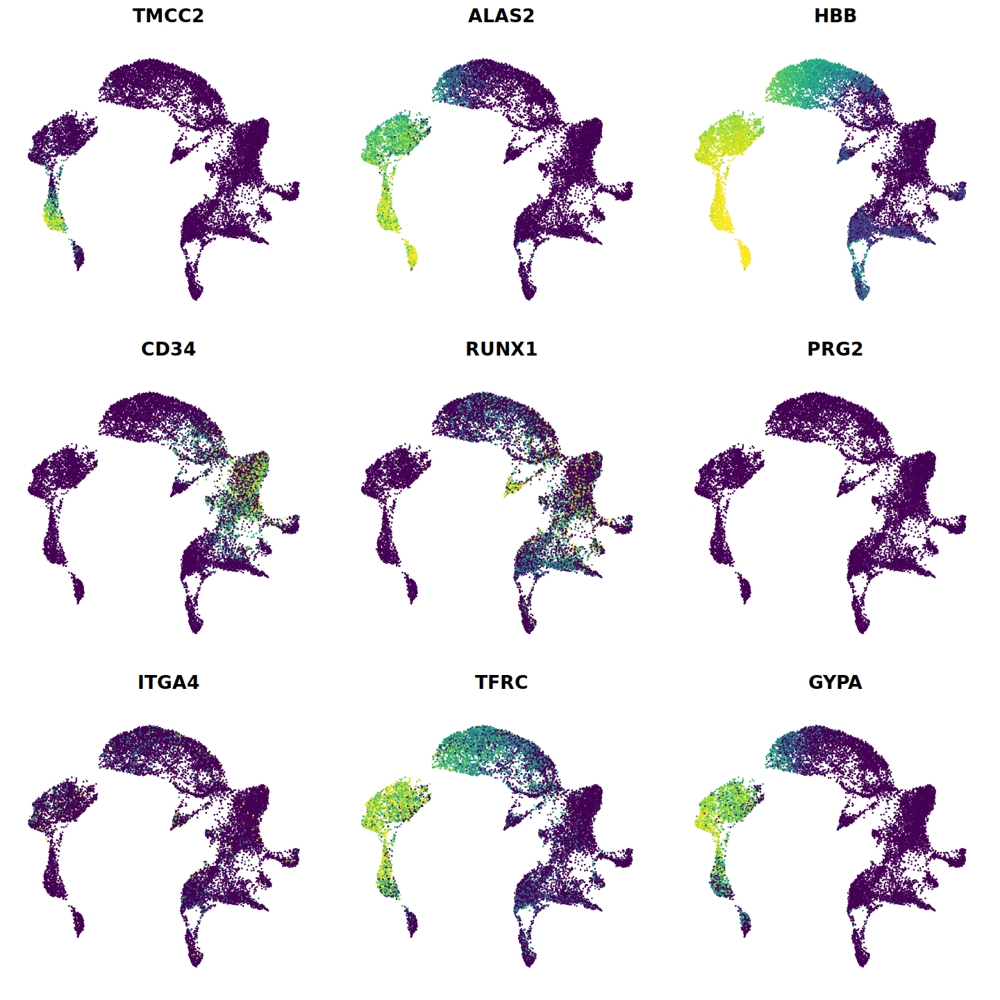

In [167]:
options(repr.plot.width=12, repr.plot.height=12)

genes = c("TMCC2", "ALAS2", "HBB", "CD34", "RUNX1", "PRG2", "ITGA4", "TFRC", "GYPA")
plot_list <- FeaturePlot(
  klein.combined,
  features=unlist(genes),
  combine=FALSE, cols=viridis(256),
  max.cutoff='q95'
)

# apply theme to each feature plot
for(i in 1:length(plot_list)){
  plot_list[[i]] <- plot_list[[i]] + umap_theme + NoLegend()
}

CombinePlots(plot_list)

In [ ]:
options(repr.plot.width=12, repr.plot.height=12)

genes = c("TMCC2", "ALAS2", "HBB", "CD34", "RUNX1", "PRG2", "ITGA4", "TFRC", "GYPA")
plot_list <- FeaturePlot(
  klein.combined,
  features=unlist(genes),
  combine=FALSE, cols=viridis(256),
  max.cutoff='q95'
)

# apply theme to each feature plot
for(i in 1:length(plot_list)){
  plot_list[[i]] <- plot_list[[i]] + umap_theme + NoLegend()
}

CombinePlots(plot_list)

Warning message:
“CombinePlots is being deprecated. Plots should now be combined using the patchwork system.”


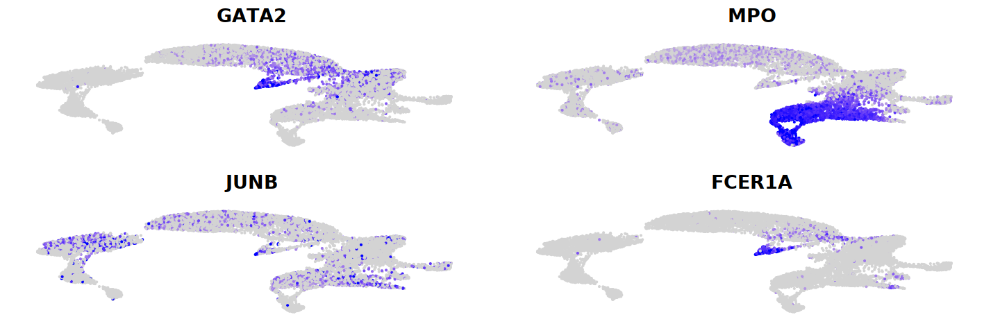

In [15]:
options(repr.plot.width=12, repr.plot.height=4)
genes = c("GATA2", "MPO", "JUNB", "FCER1A")
plot_list <- FeaturePlot(
  klein.combined,
  features=unlist(genes),
  combine=FALSE, 
  max.cutoff='q95'
)

# apply theme to each feature plot
for(i in 1:length(plot_list)){
  plot_list[[i]] <- plot_list[[i]] + umap_theme + NoLegend()
}


CombinePlots(plot_list)

## Integrate with my data

In [158]:
combined.anchors <- FindTransferAnchors(reference = klein.combined, query = ery,
    dims = 1:30, reference.reduction = "pca")

Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Found 5734 anchors

Filtering anchors

	Retained 1646 anchors



In [173]:
klein.combined <- RunUMAP(klein.combined, dims = 1:20, reduction = "pca", return.model = TRUE)
ery <- MapQuery(anchorset = combined.anchors, reference = klein.combined, query = ery,
       refdata = list(predicted_seurat = "seurat_clusters"), reference.reduction = "pca", reduction.model = "umap")

UMAP will return its model

16:14:32 UMAP embedding parameters a = 0.9922 b = 1.112

16:14:32 Read 14821 rows and found 20 numeric columns

16:14:32 Using Annoy for neighbor search, n_neighbors = 30

16:14:32 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:14:35 Writing NN index file to temp file /tmp/RtmpsqZXxQ/file7f00da62f9c

16:14:35 Searching Annoy index using 1 thread, search_k = 3000

16:14:41 Annoy recall = 100%

16:14:42 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:14:44 Initializing from normalized Laplacian + noise (using irlba)

16:14:45 Commencing optimization for 200 epochs, with 628144 positive edges

16:15:11 Optimization finished

Finding integration vectors

Finding integration vector weights

Predicti

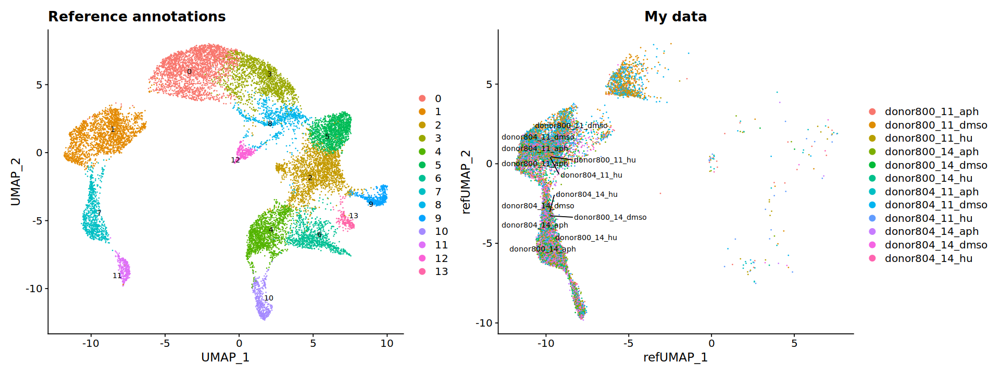

In [161]:
options(repr.plot.width=16, repr.plot.height=6)
p1 <- DimPlot(klein.combined, reduction = "umap", label = TRUE, label.size = 3,
    repel = TRUE) + ggtitle("Reference annotations")
p2 <- DimPlot(ery, reduction = "ref.umap", group.by = "sample", label = TRUE,
    label.size = 3, repel = TRUE) + ggtitle("My data")
p1 + p2

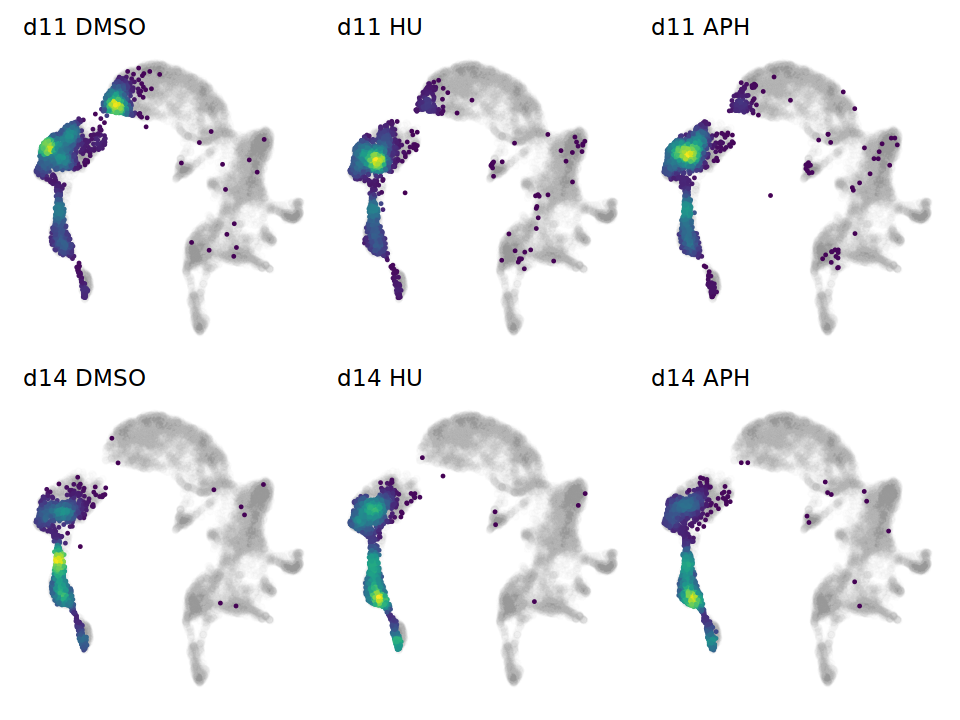

In [12]:
klein_umap_df = as.data.frame(Embeddings(klein.combined, reduction="umap"))
g = ggplot(data=klein_umap_df, aes(x=UMAP_1, y=UMAP_2)) + rasterize(geom_point(alpha=0.02, color="gray"), dpi=300)

# samples = c("donor800_11_dmso", "donor800_11_hu", "donor800_11_aph",
#             "donor804_11_dmso", "donor804_11_hu", "donor804_11_aph",
#             "donor800_14_dmso", "donor800_14_hu", "donor800_14_aph",
#             "donor804_14_dmso", "donor804_14_hu", "donor804_14_aph")

comb_samples = list(c("donor800_11_dmso", "donor804_11_dmso"),
                    c("donor800_11_hu", "donor804_11_hu"),
                    c("donor800_11_aph", "donor804_11_aph"),
                    c("donor800_14_dmso", "donor804_14_dmso"),
                    c("donor800_14_hu", "donor804_14_hu"),
                    c("donor800_14_aph", "donor804_14_aph"))
plot_names = c("d11 DMSO", "d11 HU", "d11 APH", "d14 DMSO", "d14 HU", "d14 APH")

ery_umap_df = as.data.frame(Embeddings(ery, reduction="ref.umap"))
plot_list = list()
for (i in 1:6) {
    umap_ss = ery_umap_df[rownames(subset(ery@meta.data, sample %in% comb_samples[[i]])),]
    plot_list[[i]] = g + geom_pointdensity(data=umap_ss, aes(x=refUMAP_1, y=refUMAP_2), 
                                           size=0.3, adjust=1) + 
                  umap_theme + NoLegend() + ggtitle(plot_names[i]) + scale_color_viridis()
}

options(repr.plot.width=8, repr.plot.height=6)
wrap_plots(plot_list, ncol=3)
ggsave("230607_bd391_points_mapped_to_klein.pdf", width=6, height=4)

## What's different between stage matched cells?

In [ ]:
# mapping to predicted 
# clusters 0, 1, 7, and 11 are the relevant ones.

In [177]:
ery@meta.data$day = sapply(ery@meta.data$sample, function(x) strsplit(x, "_")[[1]][2])
head(ery@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample,RNA_snn_res.0.5,seurat_clusters,donor,tx,predicted.predicted_seurat.score,predicted.predicted_seurat,day
,<fct>,<dbl>,<int>,<dbl>,<chr>,<fct>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>
AAACCCAAGACAAGCC-1,ery,5013,1164,0.03989627,donor804_14_hu,7,7,donor804,hu,0.8439966,1,14
AAACCCAAGACATCCT-1,ery,697,287,0.28694405,donor804_14_aph,0,0,donor804,aph,0.9825632,7,14
AAACCCAAGAGCATTA-1,ery,4929,766,0.20288091,donor800_14_aph,0,0,donor800,aph,0.8096007,7,14
AAACCCAAGCCGGAAT-1,ery,20163,3018,0.89272430,donor800_11_aph,4,4,donor800,aph,1.0000000,1,11
AAACCCACAACAACAA-1,ery,4964,621,0.06043513,donor800_14_hu,0,0,donor800,hu,0.8068553,7,14
AAACCCACAACCAACT-1,ery,1532,555,0.00000000,donor800_11_dmso,4,4,donor800,dmso,0.7410474,1,11


In [12]:
z = subset(ery, predicted.predicted_seurat == "1" & day == "11")
Idents(object = z) <- "tx"
c1_d11_hu_dmso <- FindMarkers(z, ident.1 = "hu", ident.2 = "dmso")
c1_d11_aph_dmso <- FindMarkers(z, ident.1 = "aph", ident.2 = "dmso")


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

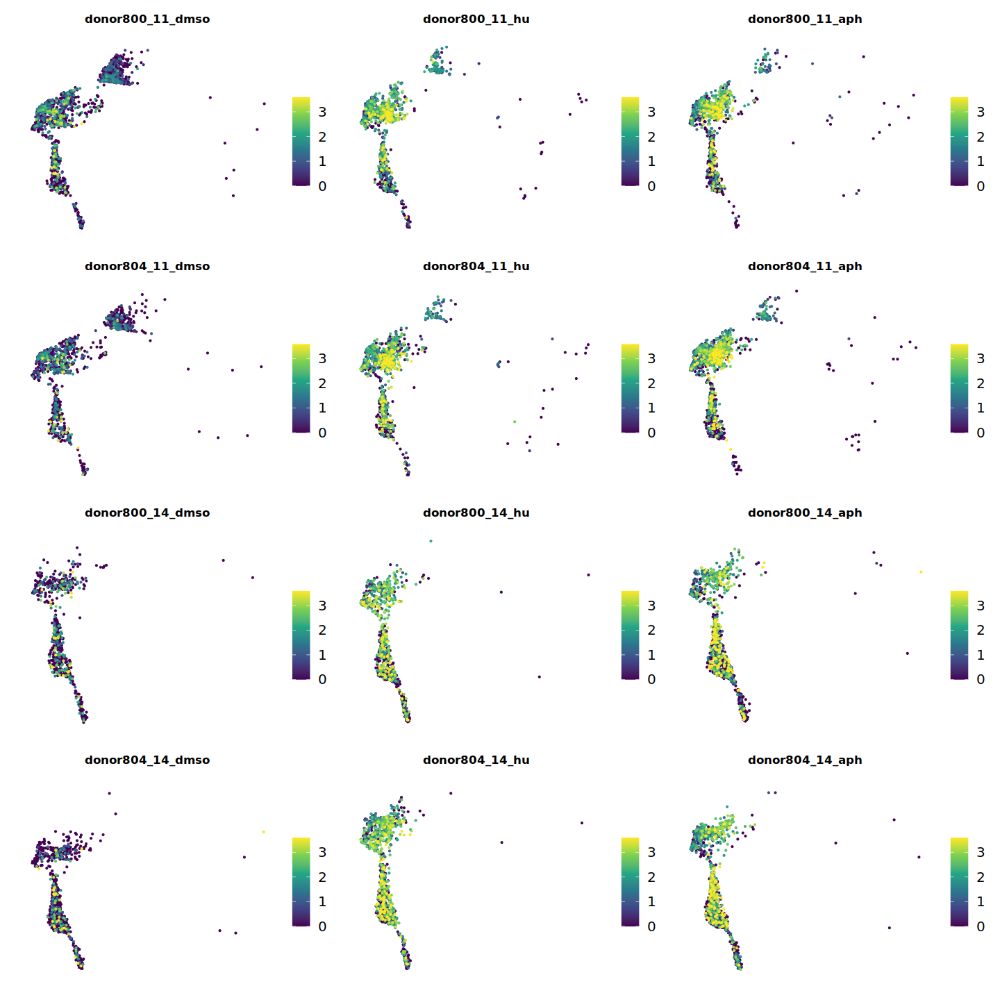

In [276]:
# samples = c("donor800_11_dmso", "donor800_11_hu", "donor800_11_aph",
#             "donor804_11_dmso", "donor804_11_hu", "donor804_11_aph",
#             "donor800_14_dmso", "donor800_14_hu", "donor800_14_aph",
#             "donor804_14_dmso", "donor804_14_hu", "donor804_14_aph")

# https://divingintogeneticsandgenomics.rbind.io/post/customize-featureplot-in-seurat-for-multi-condition-comparisons-using-patchwork/
Idents(object = ery) <- "sample"

library(scales)
FeaturePlotSingle<- function(obj, max_val=1, feature, metadata_column, ...){
  all_cells <- colnames(obj)
  groups <- c("donor800_11_dmso", "donor800_11_hu", "donor800_11_aph",
             "donor804_11_dmso", "donor804_11_hu", "donor804_11_aph",
             "donor800_14_dmso", "donor800_14_hu", "donor800_14_aph",
             "donor804_14_dmso", "donor804_14_hu", "donor804_14_aph")
  
  # the minimal and maximal of the value to make the legend scale the same. 
  minimal <- min(obj[['RNA']]@data[feature, ])
  maximal <- max(obj[['RNA']]@data[feature, ])*max_val
  ps<- list()
  for (group in groups) {
    subset_indx <- obj@meta.data[, metadata_column] == group
    subset_cells <- all_cells[subset_indx]
    p <- FeaturePlot(obj, features = feature, cells= subset_cells, pt.size = 0.5, ...) +
      scale_color_viridis_c(limits=c(minimal, maximal), direction = 1, oob=squish) +
      ggtitle(group) + umap_theme +
      theme(plot.title = element_text(size = 10, face = "bold"))
    ps[[group]] <- p
  }
  
  
  return(ps)
}

p_list <- FeaturePlotSingle(ery, max_val=0.6, feature= "GDF15", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)



Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

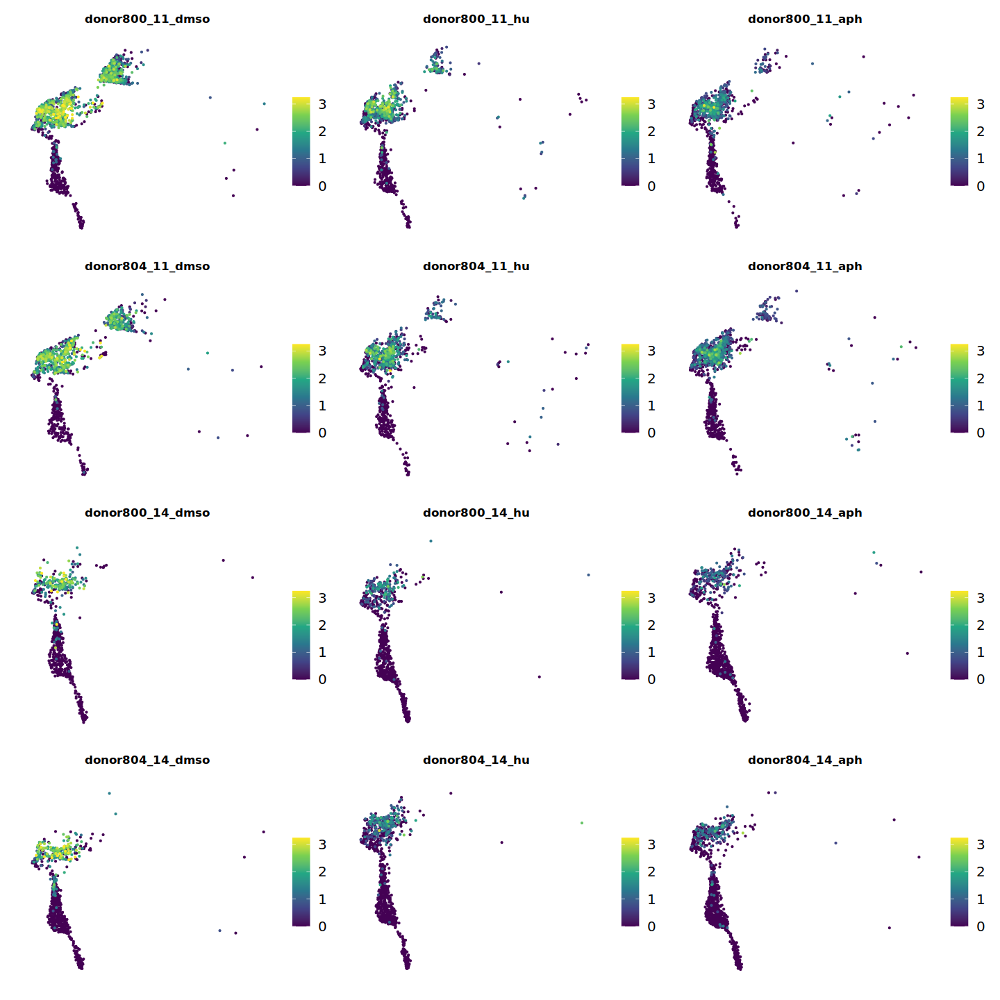

In [250]:
p_list <- FeaturePlotSingle(ery, max_val=0.6, feature= "HIST1H1D", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

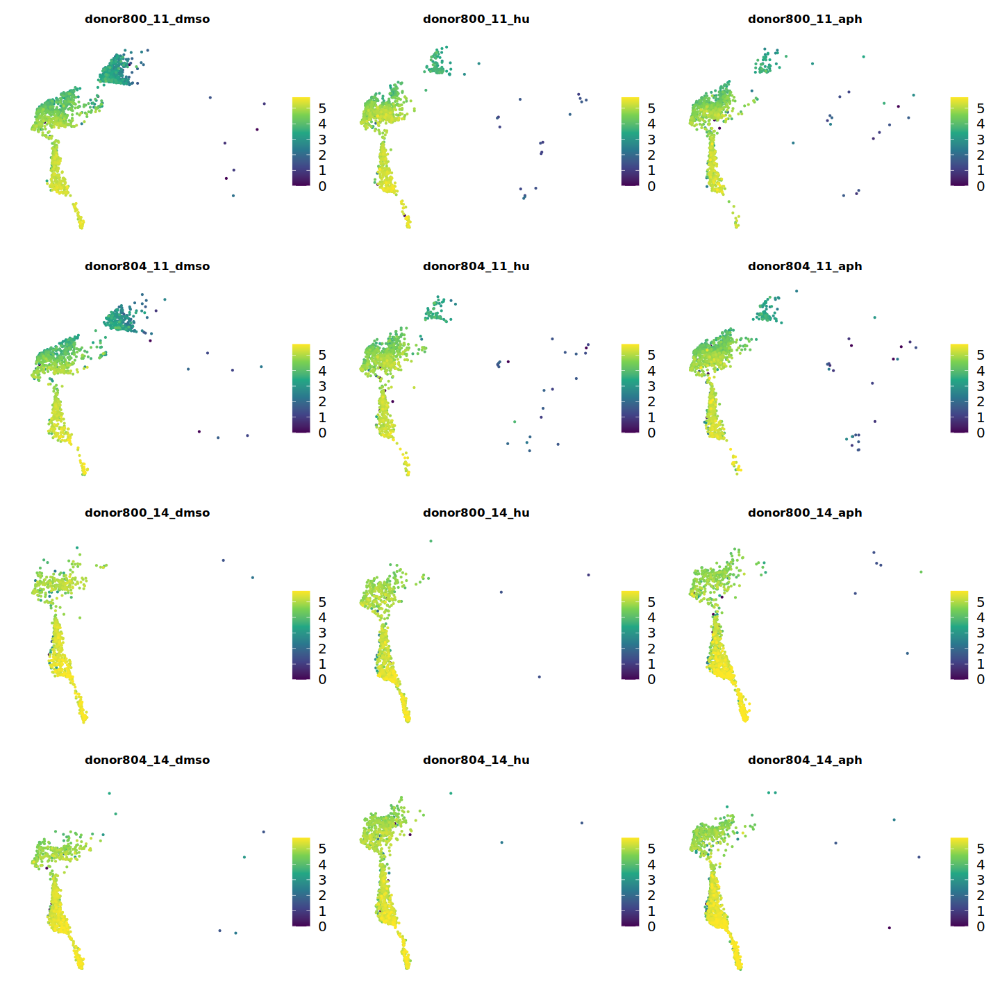

In [253]:
p_list <- FeaturePlotSingle(ery, max_val=0.8, feature= "HBA1", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

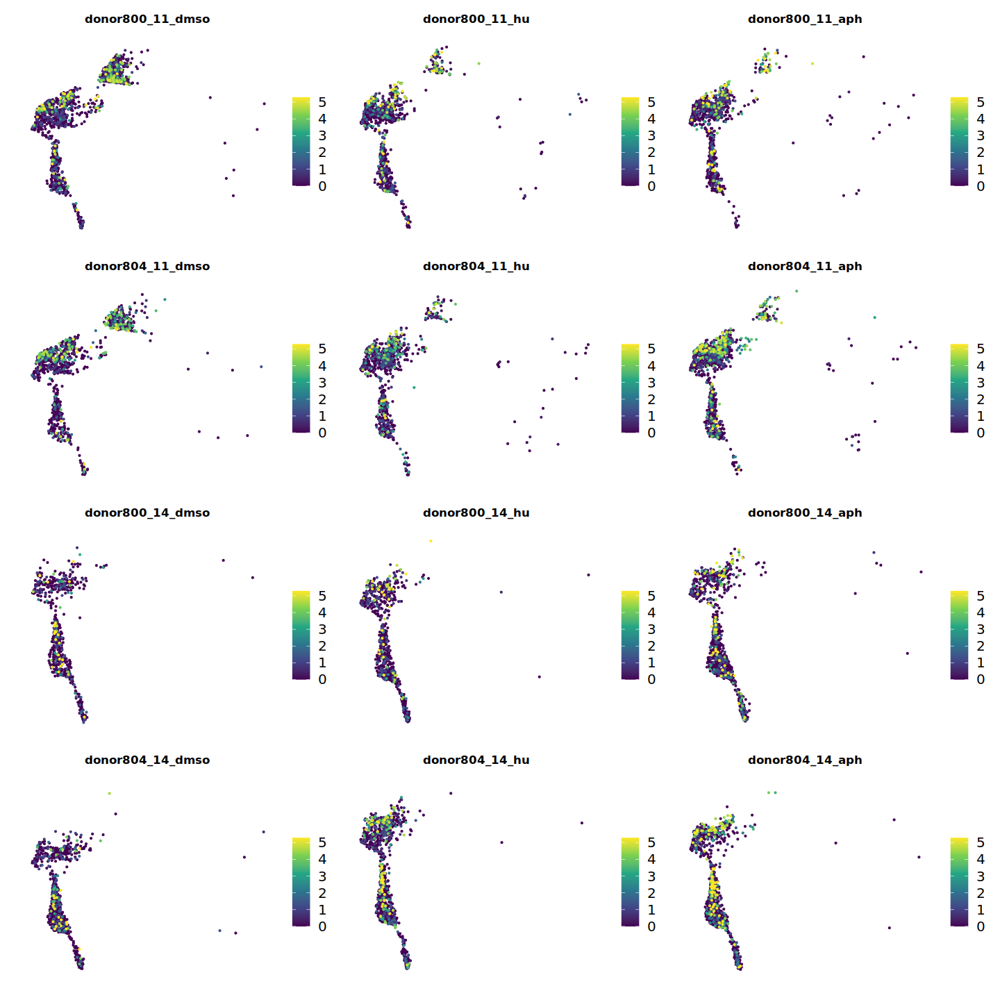

In [254]:
p_list <- FeaturePlotSingle(ery, max_val=0.8, feature= "HBG1", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

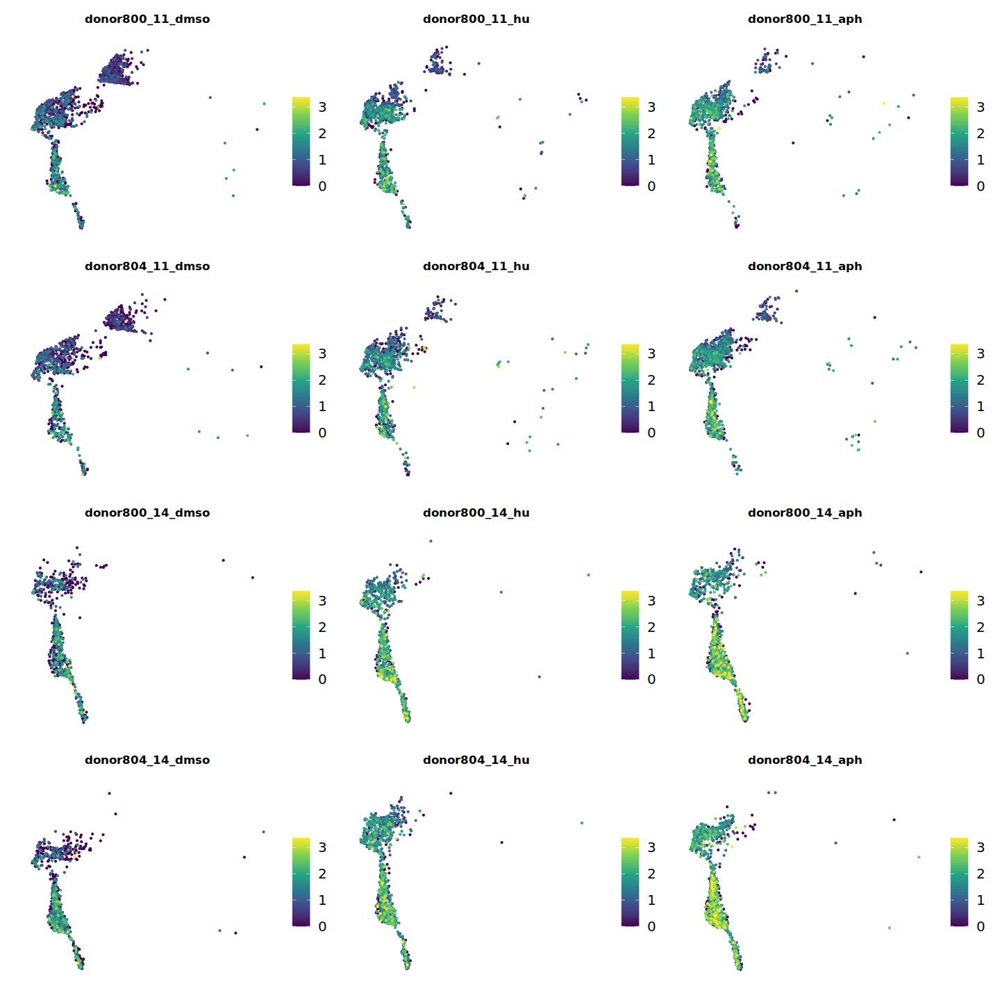

In [263]:
p_list <- FeaturePlotSingle(ery, max_val=0.8, feature= "HLA-A", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

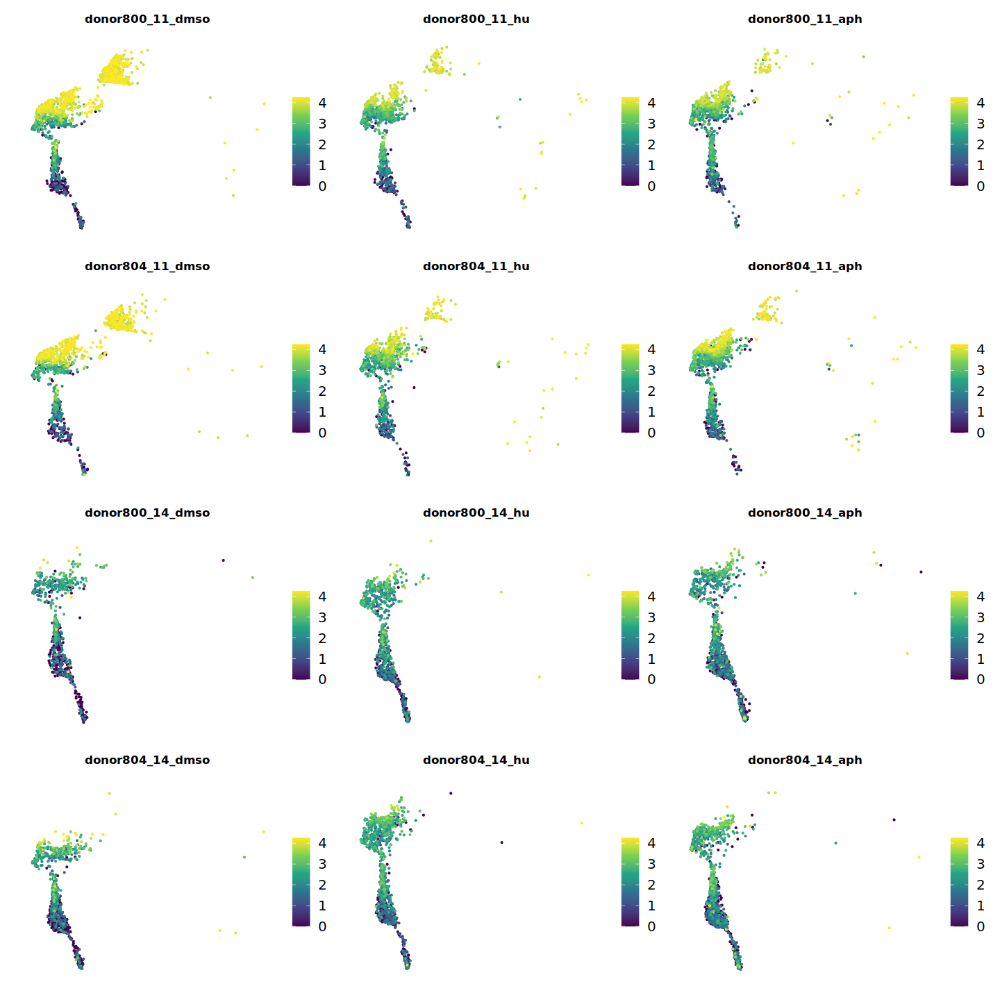

In [274]:
p_list <- FeaturePlotSingle(ery, max_val=0.8, feature= "RPS8", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is

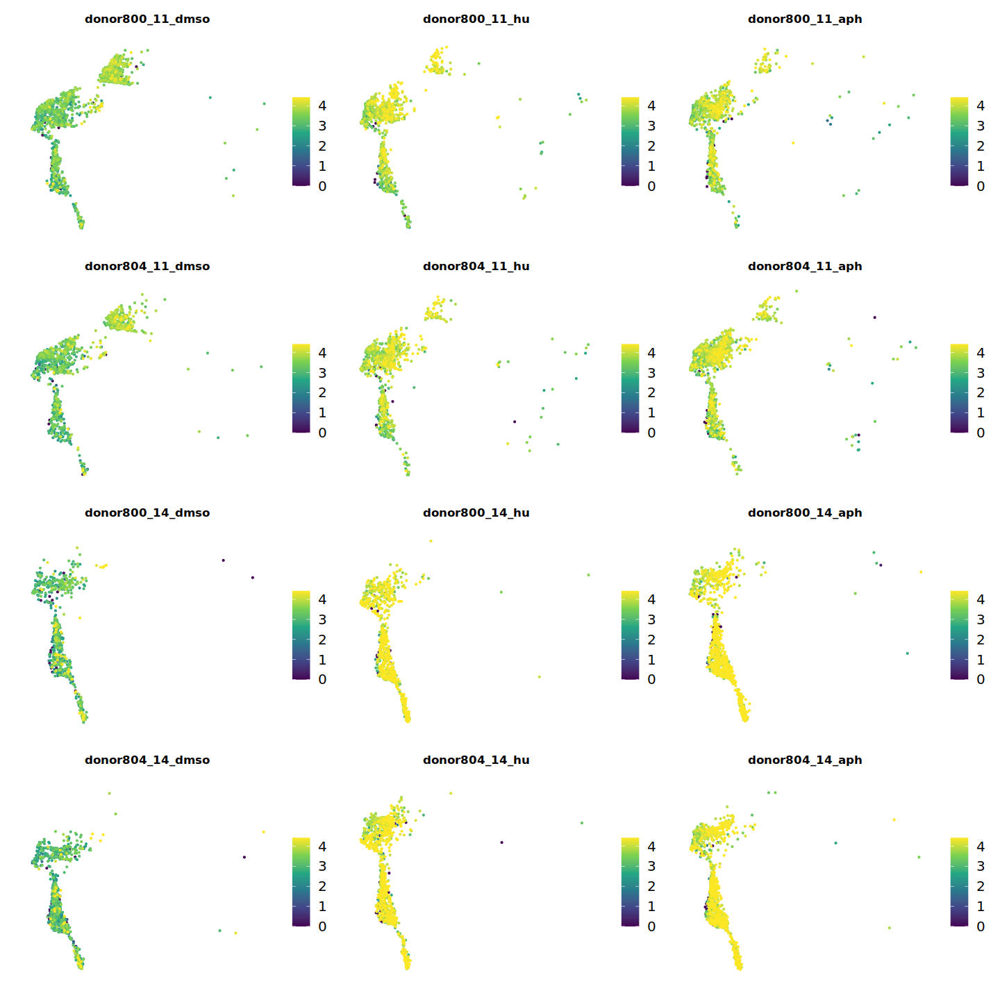

In [275]:
p_list <- FeaturePlotSingle(ery, max_val=0.6, feature= "FTL", metadata_column = "sample", 
                           reduction = "ref.umap", order = TRUE)

options(repr.plot.width=12, repr.plot.height=12)
wrap_plots(p_list, ncol=3)

Warning message:
“ggrepel: 601 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 661 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


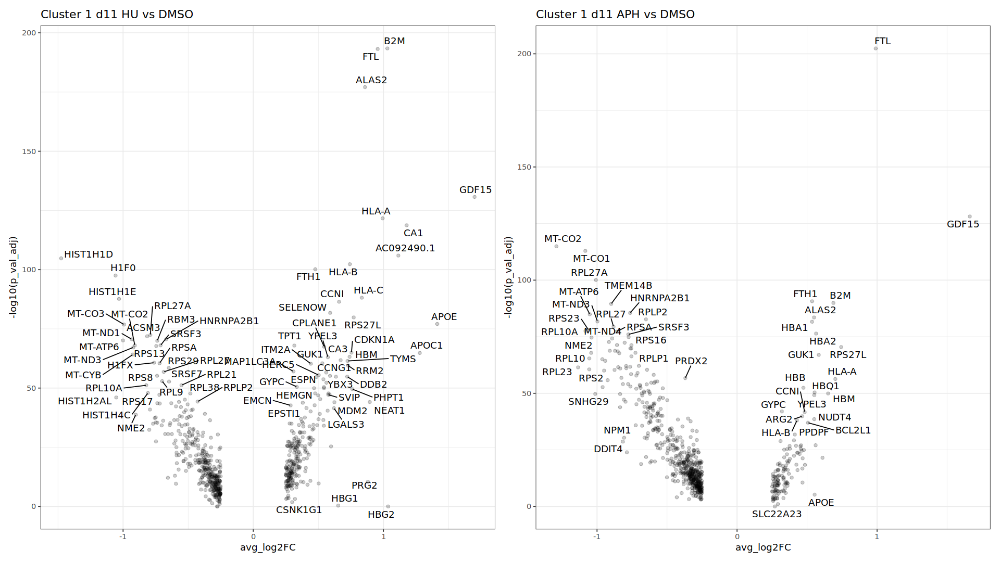

In [265]:
g1 = ggplot(c1_d11_aph_dmso, aes(x=avg_log2FC, y=-log10(p_val_adj))) + geom_point(alpha=0.2) + 
       geom_text_repel(aes(label=rownames(c1_d11_aph_dmso)), max.overlaps=20) + 
       theme_bw() + ggtitle("Cluster 1 d11 HU vs DMSO")

g2 = ggplot(c1_d11_hu_dmso, aes(x=avg_log2FC, y=-log10(p_val_adj))) + geom_point(alpha=0.2) + 
       geom_text_repel(aes(label=rownames(c1_d11_hu_dmso)), max.overlaps=20) + 
       theme_bw() + ggtitle("Cluster 1 d11 APH vs DMSO")

options(repr.plot.width=16, repr.plot.height=9)
g1 + g2

In [42]:
z = subset(ery, tx == "dmso")
Idents(object = z) <- "day"
d14_vs_d11 <- FindMarkers(z, ident.1 = "14", ident.2 = "11")


Warning message:
“ggrepel: 2276 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


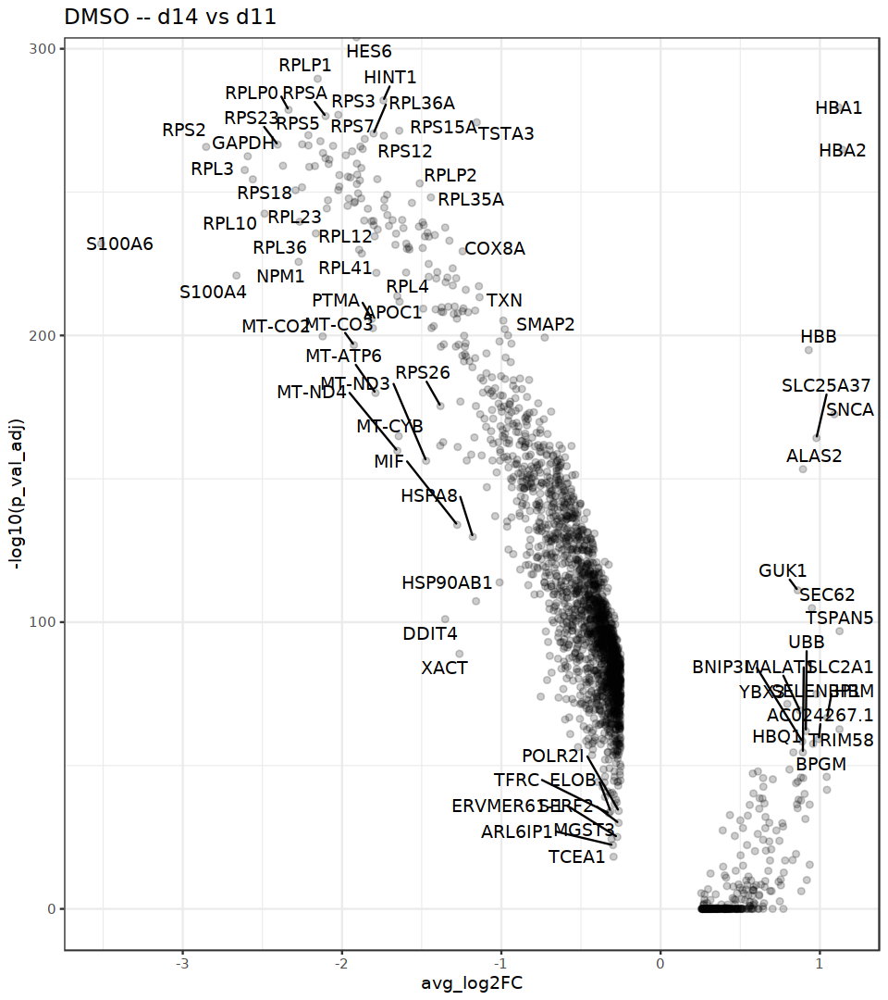

In [44]:
g1 = ggplot(d14_vs_d11, aes(x=avg_log2FC, y=-log10(p_val_adj))) + geom_point(alpha=0.2) + 
       geom_text_repel(aes(label=rownames(d14_vs_d11)), max.overlaps=20) + 
       theme_bw() + ggtitle("DMSO -- d14 vs d11")

options(repr.plot.width=8, repr.plot.height=9)
g1

In [11]:
z = subset(ery, predicted.predicted_seurat == "7" & day == "14")
Idents(object = z) <- "tx"
c7_d14_hu_dmso <- FindMarkers(z, ident.1 = "hu", ident.2 = "dmso")
c7_d14_aph_dmso <- FindMarkers(z, ident.1 = "aph", ident.2 = "dmso")


Warning message:
“ggrepel: 484 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 576 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


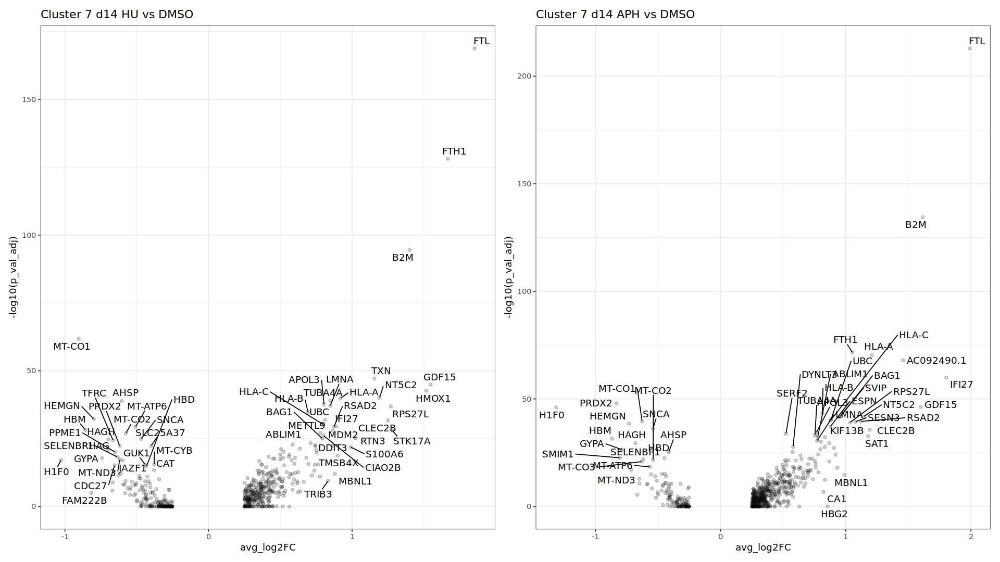

In [266]:
g1 = ggplot(c7_d14_hu_dmso, aes(x=avg_log2FC, y=-log10(p_val_adj))) + geom_point(alpha=0.2) + 
       geom_text_repel(aes(label=rownames(c7_d14_hu_dmso)), max.overlaps=20) + 
       theme_bw() + ggtitle("Cluster 7 d14 HU vs DMSO")

g2 = ggplot(c7_d14_aph_dmso, aes(x=avg_log2FC, y=-log10(p_val_adj))) + geom_point(alpha=0.2) + 
       geom_text_repel(aes(label=rownames(c7_d14_aph_dmso)), max.overlaps=20) + 
       theme_bw() + ggtitle("Cluster 7 d14 APH vs DMSO")

options(repr.plot.width=16, repr.plot.height=9)
g1 + g2

In [269]:
c1_d11_aph_dmso["CDKN1A",]
c1_d11_hu_dmso["CDKN1A",]
c7_d14_aph_dmso["CDKN1A",]
c7_d14_hu_dmso["CDKN1A",]

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CDKN1A,4.433544e-70,0.7544956,0.316,0.039,1.049686e-65


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CDKN1A,7.877076e-18,0.3348754,0.139,0.039,1.864977e-13


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NA,NA,NA,NA,NA,NA


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CDKN1A,4.396335e-16,0.4357783,0.107,0.012,1.040876e-11


In [273]:
write.csv(c1_d11_aph_dmso, "230425_c1_d11_aph_dmso.csv", quote=F)
write.csv(c1_d11_hu_dmso, "230425_c1_d11_hu_dmso.csv", quote=F)
write.csv(c7_d14_aph_dmso, "230425_c7_d14_aph_dmso.csv", quote=F)
write.csv(c7_d14_hu_dmso, "230425_c7_d14_hu_dmso.csv", quote=F)

In [18]:
length(rownames(ery))

[1] 23676

## Enrichr

In [13]:
d11_up = intersect(rownames(subset(c1_d11_aph_dmso, avg_log2FC > 0 & p_val_adj < 0.05)),
                   rownames(subset(c1_d11_hu_dmso, avg_log2FC > 0 & p_val_adj < 0.05)))
d11_up_enr <- enrichr(d11_up, c("KEGG_2021_Human", "MSigDB_Hallmark_2020"))

[1] "B2M"        "FTL"        "ALAS2"      "GDF15"      "HLA-A"     
  [6] "CA1"        "AC092490.1" "HLA-B"      "FTH1"       "HLA-C"     
 [11] "CCNI"       "SELENOW"    "RPS27L"     "APOE"       "CPLANE1"   
 [16] "CDKN1A"     "HBM"        "YPEL3"      "TYMS"       "GUK1"      
 [21] "RRM2"       "YBX3"       "DDB2"       "ST8SIA1"    "ESPN"      
 [26] "FBXL5"      "TXNIP"      "GYPC"       "CRNDE"      "PPDPF"     
 [31] "SNCA"       "FDXR"       "SVIP"       "RGS10"      "TMEM106C"  
 [36] "NEAT1"      "MDM2"       "HEMGN"      "BCL2L1"     "LGALS3"    
 [41] "STK17A"     "AC100810.1" "ZNF428"     "BAX"        "FAM210B"   
 [46] "FAS"        "MRPL57"     "XG"         "ZFP36L2"    "SLC14A1"   
 [51] "DNAJC1"     "SLC25A37"   "RAP1GAP"    "TERF2IP"    "ARG2"      
 [56] "HBQ1"       "BBC3"       "HBA2"       "BLOC1S2"    "SDSL"      
 [61] "UBXN6"      "RBM38"      "PNRC1"      "DGKH"       "BTG3"      
 [66] "JUND"       "NEURL1B"    "CENPM"      "HBZ"        "NUDT4"     
 [71] "ISG20"      "GADD45A"    "GABARAP"    "PLCL2"      "MKI67"     
 [76] "STMP1"      "HBA1"       "EIF2AK1"    "RHEB"       "SAC3D1"    
 [81] "ANKRD9"     "LINC02772"  "WNK1"       "OPTN"       "ISCU"      
 [86] "STOM"       "BTG2"       "SEC14L1"    "BNIP3L"     "CYSTM1"    
 [91] "HSPB1"      "NFAT5"      "FOXO3"      "CPEB4"      "TUBA4A"    
 [96] "SPTA1"      "TRAK2"      "TSPAN5"     "MARCH3"     "ATAD2"

In [21]:
d14_up = intersect(rownames(subset(c7_d14_aph_dmso, avg_log2FC > 0 & p_val_adj < 0.05)),
                   rownames(subset(c7_d14_hu_dmso, avg_log2FC > 0 & p_val_adj < 0.05)))
d14_up_enr <- enrichr(d14_up, c("KEGG_2021_Human", "MSigDB_Hallmark_2020"))

Uploading data to Enrichr... Done.
  Querying KEGG_2021_Human... Done.
  Querying MSigDB_Hallmark_2020... Done.
Parsing results... Done.


In [20]:
d11_down = intersect(rownames(subset(c1_d11_aph_dmso, avg_log2FC < 0 & p_val_adj < 0.05)),
                   rownames(subset(c1_d11_hu_dmso, avg_log2FC < 0 & p_val_adj < 0.05)))
d11_down_enr <- enrichr(d11_down, c("KEGG_2021_Human", "MSigDB_Hallmark_2020"))

Uploading data to Enrichr... Done.
  Querying KEGG_2021_Human... Done.
  Querying MSigDB_Hallmark_2020... Done.
Parsing results... Done.


In [22]:
d14_down = intersect(rownames(subset(c7_d14_aph_dmso, avg_log2FC < 0 & p_val_adj < 0.05)),
                   rownames(subset(c7_d14_hu_dmso, avg_log2FC < 0 & p_val_adj < 0.05)))
d14_down_enr <- enrichr(d14_down, c("KEGG_2021_Human", "MSigDB_Hallmark_2020"))

Uploading data to Enrichr... Done.
  Querying KEGG_2021_Human... Done.
  Querying MSigDB_Hallmark_2020... Done.
Parsing results... Done.


`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”


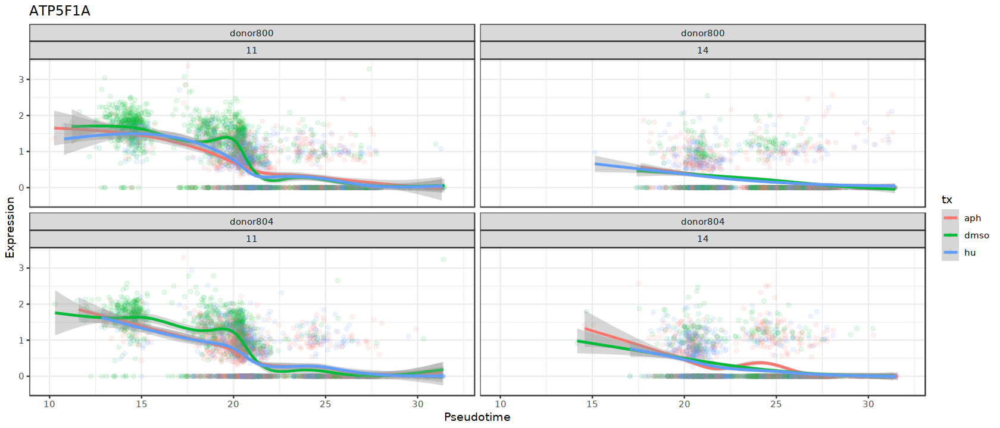

In [41]:
options(repr.plot.width=14, repr.plot.height=6)
plot_gene("ATP5F1A")

In [51]:
head(d14_down_enr[[2]], 10)

,Term,Overlap,P.value,Adjusted.P.value,Old.P.value,Old.Adjusted.P.value,Odds.Ratio,Combined.Score,Genes
,<chr>,<chr>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<chr>
1,heme Metabolism,20/200,1.409251e-26,1.550176e-25,0,0,62.746032,3734.904480,GYPA;TFRC;MGST3;ACSL6;HBD;EPOR;MYL4;SELENBP1;SPTA1;KAT2B;PRDX2;DAAM1;CDC27;HMBS;AHSP;RHAG;HAGH;TRIM10;FBXO9;SNCA
2,Mitotic Spindle,2/199,1.039306e-01,2.780126e-01,0,0,3.782779,8.564333,ITSN1;CDC27
3,mTORC1 Signaling,2/200,1.048020e-01,2.780126e-01,0,0,3.763484,8.489223,TFRC;HMBS
4,Adipogenesis,2/200,1.048020e-01,2.780126e-01,0,0,3.763484,8.489223,MGST3;ITSN1
5,Reactive Oxygen Species Pathway,1/49,1.263694e-01,2.780126e-01,0,0,7.676312,15.878804,PRDX2
6,UV Response Up,1/158,3.539102e-01,4.250768e-01,0,0,2.334041,2.424396,TFRC
7,Myogenesis,1/200,4.250768e-01,4.250768e-01,0,0,1.837521,1.571972,MYL4
8,Hypoxia,1/200,4.250768e-01,4.250768e-01,0,0,1.837521,1.571972,SELENBP1
9,Oxidative Phosphorylation,1/200,4.250768e-01,4.250768e-01,0,0,1.837521,1.571972,MGST3


`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 

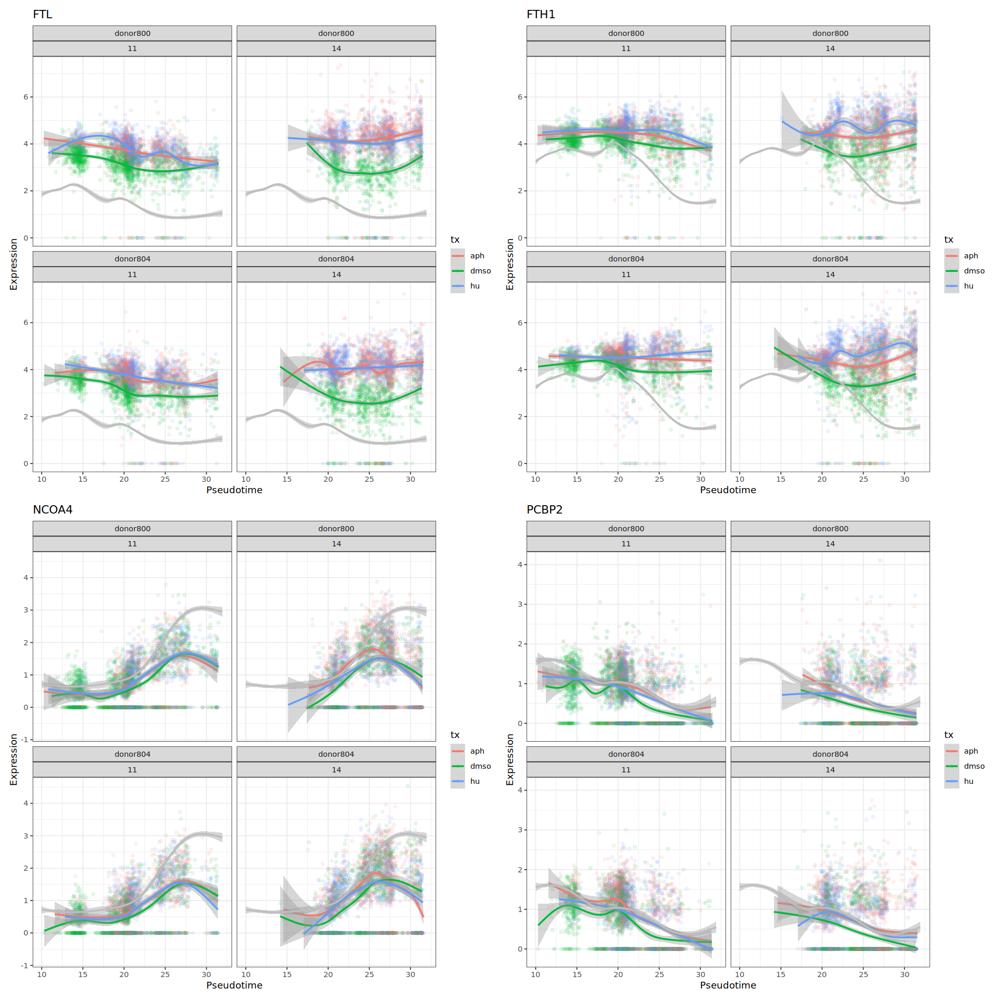

In [94]:
(plot_gene("FTL") + plot_gene("FTH1")) / (plot_gene("NCOA4") + plot_gene("PCBP2"))

# Plot cells along trajectory

In [278]:
# http://htmlpreview.github.io/?https://github.com/satijalab/seurat-wrappers/blob/master/docs/monocle3.html

Warning message:
“Monocle 3 trajectories require cluster partitions, which Seurat does not calculate. Please run 'cluster_cells' on your cell_data_set object”


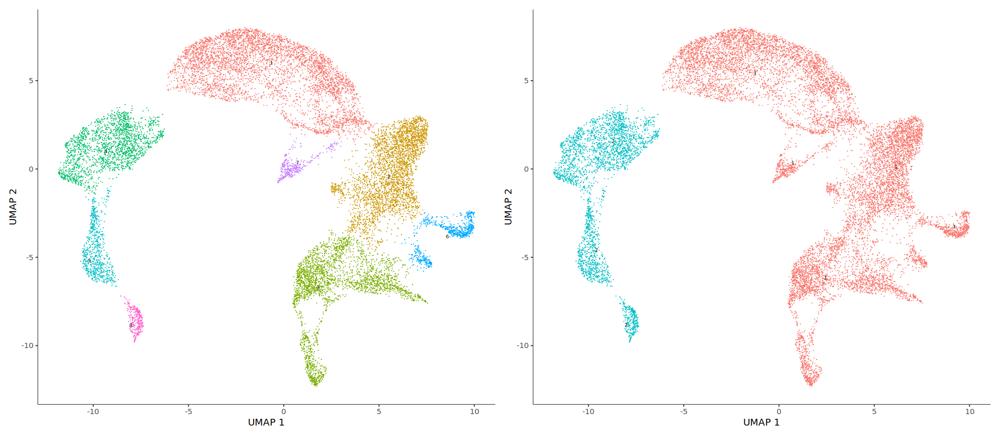

In [282]:
klein.cds <- as.cell_data_set(klein.combined)

klein.cds <- cluster_cells(klein.cds)
p1 <- plot_cells(klein.cds, show_trajectory_graph = FALSE)
p2 <- plot_cells(klein.cds, color_cells_by = "partition", show_trajectory_graph = FALSE)

options(repr.plot.width=16, repr.plot.height=7)
wrap_plots(p1, p2)

  |======================================================================| 100%


Warning message in igraph::graph.dfs(stree_ori, root = root_cell, neimode = "all", :
“Argument `neimode' is deprecated; use `mode' instead”


  |======================================================================| 100%


Warning message in igraph::graph.dfs(stree_ori, root = root_cell, neimode = "all", :
“Argument `neimode' is deprecated; use `mode' instead”


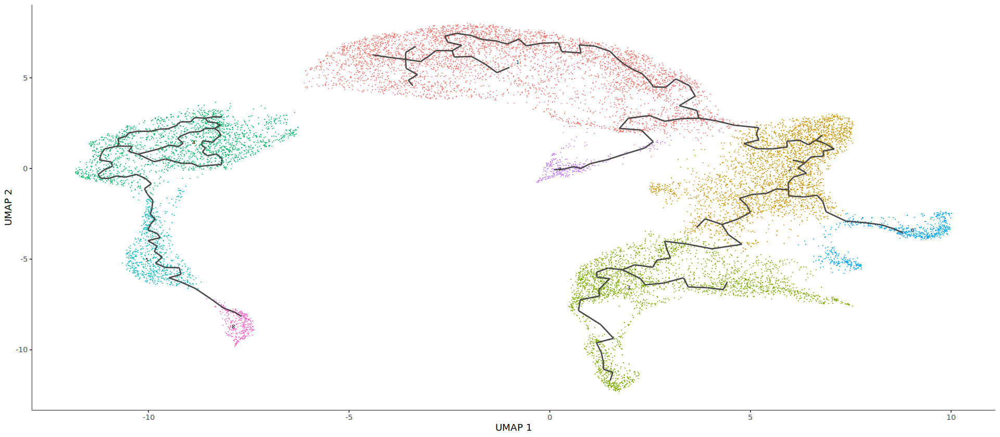

In [296]:
# integrated.sub <- subset(as.Seurat(klein.cds, assay="RNA"), monocle3_partitions == 1)
# klein.cds <- as.cell_data_set(integrated.sub)
klein.cds <- learn_graph(klein.cds)
plot_cells(klein.cds, label_groups_by_cluster = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

In [297]:
integrated.sub <- as.Seurat(klein.cds, assay = "integrated")
FeaturePlot(integrated.sub, "monocle3_pseudotime")

ERROR: Error in as.Seurat.SingleCellExperiment(x = as(object = x, Class = "SingleCellExperiment"), : One or more of the assays you are trying to convert is not in the SingleCellExperiment object


# Slingshot

In [313]:
library(slingshot)
library(RColorBrewer)

# https://bioconductor.org/packages/devel/bioc/vignettes/slingshot/inst/doc/vignette.html

Warning message:
“package ‘RColorBrewer’ was built under R version 4.2.1”


In [315]:
klein.cds <- slingshot(klein.cds, clusterLabels = 'seurat_clusters', reducedDim = 'UMAP', start.clus = '5')

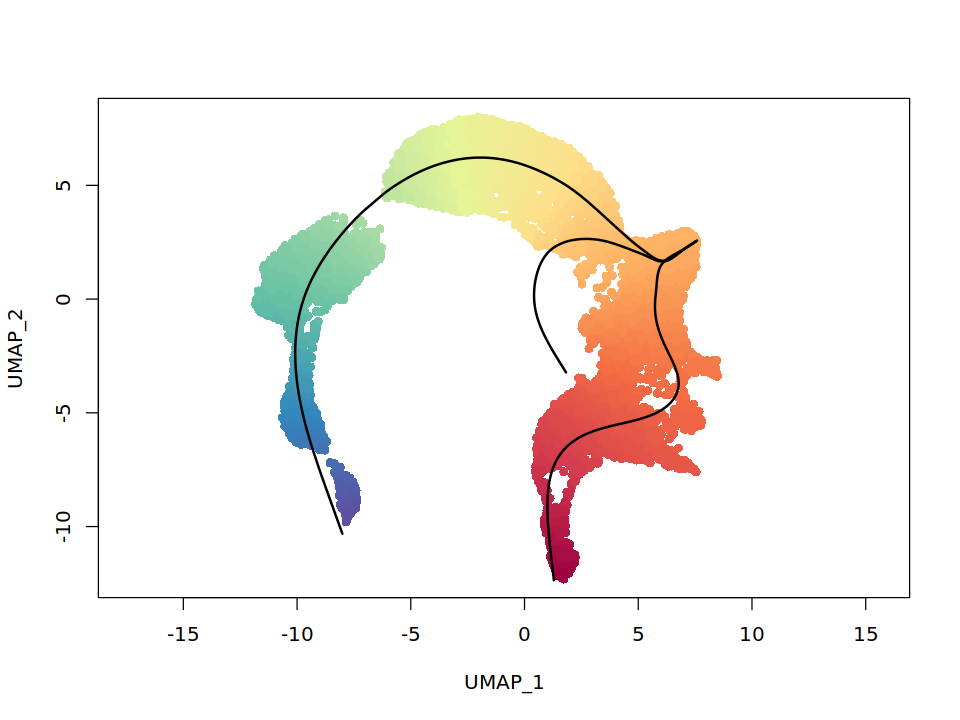

In [330]:
colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)
plotcol <- colors[cut(klein.cds$slingPseudotime_1, breaks=100)]

options(repr.plot.width=8, repr.plot.height=6)
plot(reducedDims(klein.cds)$UMAP, col = plotcol, pch=16, asp = 1)
lines(SlingshotDataSet(klein.cds), lwd=2, col='black')

In [326]:
SlingshotDataSet(klein.cds)  # use Lineage2

class: SlingshotDataSet 

 Samples Dimensions
   14821          2

lineages: 3 
Lineage1: 5  2  9  13  6  4  10  
Lineage2: 5  8  3  0  1  7  11  
Lineage3: 5  8  12  

curves: 3 
Curve1: Length: 19.32	Samples: 6607.35
Curve2: Length: 32.355	Samples: 8754.04
Curve3: Length: 12.897	Samples: 2298.41

In [333]:
ery_umap_df_pred = slingshot::predict(klein.cds$slingshot, ery_umap_df)

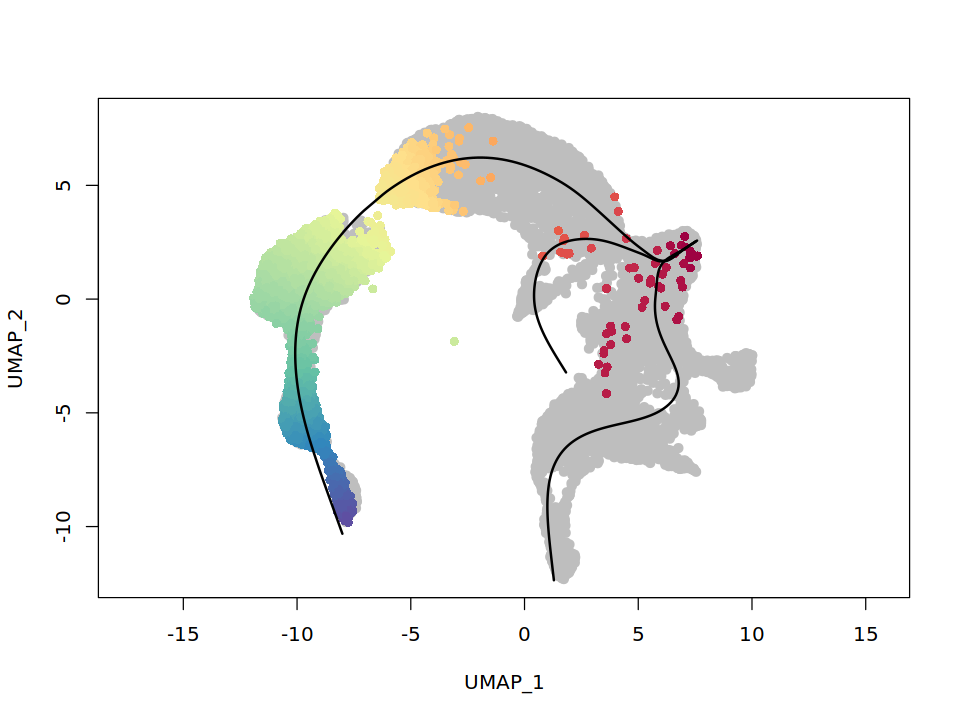

In [341]:
newplotcol <- colors[cut(slingPseudotime(ery_umap_df_pred)[,2], breaks=100)]
plot(reducedDims(klein.cds)$UMAP, col = 'grey', bg = 'grey', pch=21, asp = 1)
points(slingReducedDim(ery_umap_df_pred), col = newplotcol, pch = 16)
lines(SlingshotDataSet(klein.cds), lwd=2, col = 'black')

In [343]:
head(slingPseudotime(ery_umap_df_pred))

,Lineage1,Lineage2,Lineage3
AAACCCAAGACAAGCC-1,NA,22.30448,NA
AAACCCAAGACATCCT-1,NA,27.54447,NA
AAACCCAAGAGCATTA-1,NA,26.69968,NA
AAACCCAAGCCGGAAT-1,NA,20.32027,NA
AAACCCACAACAACAA-1,NA,27.56256,NA
AAACCCACAACCAACT-1,NA,17.62002,NA


In [349]:
ery@meta.data$sling = slingPseudotime(ery_umap_df_pred)[,"Lineage2"]
head(ery@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample,RNA_snn_res.0.5,seurat_clusters,donor,tx,predicted.predicted_seurat.score,predicted.predicted_seurat,day,sling
,<fct>,<dbl>,<int>,<dbl>,<chr>,<fct>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>
AAACCCAAGACAAGCC-1,ery,5013,1164,0.03989627,donor804_14_hu,7,7,donor804,hu,0.8439966,1,14,22.30448
AAACCCAAGACATCCT-1,ery,697,287,0.28694405,donor804_14_aph,0,0,donor804,aph,0.9825632,7,14,27.54447
AAACCCAAGAGCATTA-1,ery,4929,766,0.20288091,donor800_14_aph,0,0,donor800,aph,0.8096007,7,14,26.69968
AAACCCAAGCCGGAAT-1,ery,20163,3018,0.89272430,donor800_11_aph,4,4,donor800,aph,1.0000000,1,11,20.32027
AAACCCACAACAACAA-1,ery,4964,621,0.06043513,donor800_14_hu,0,0,donor800,hu,0.8068553,7,14,27.56256
AAACCCACAACCAACT-1,ery,1532,555,0.00000000,donor800_11_dmso,4,4,donor800,dmso,0.7410474,1,11,17.62002


Warning message:
“Removed 58 rows containing non-finite values (`stat_density()`).”


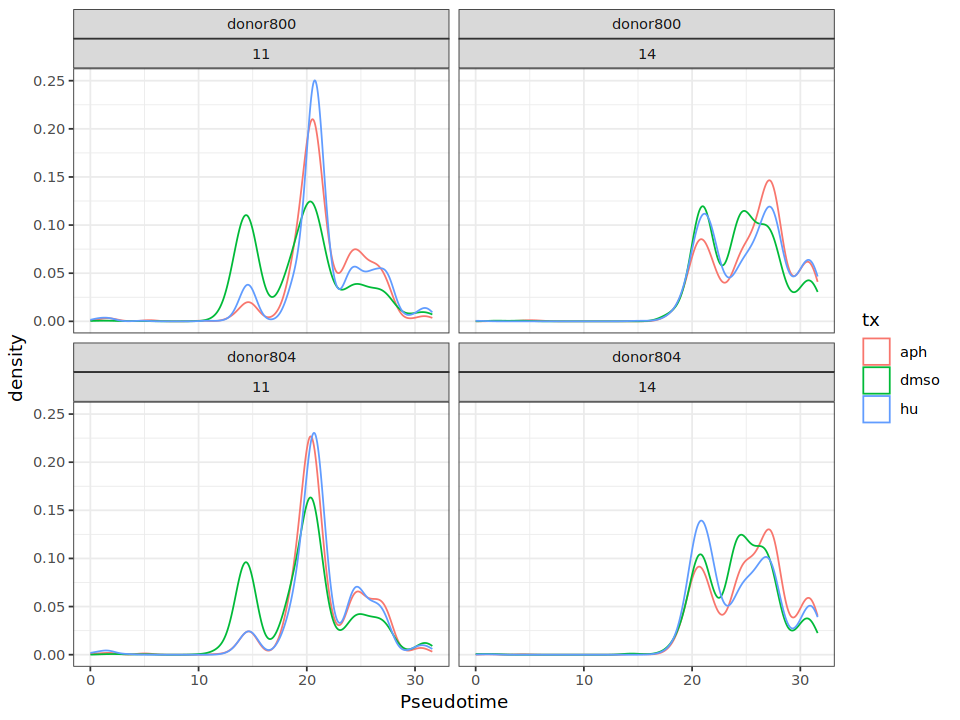

In [361]:
ggplot(ery@meta.data, aes(x=sling, color=tx)) + geom_density() + 
facet_wrap(vars(donor, day)) + xlab("Pseudotime") + theme_bw()

Warning message:
“Removed 116 rows containing non-finite values (`stat_density()`).”
Warning message:
“Removed 116 rows containing non-finite values (`stat_density()`).”


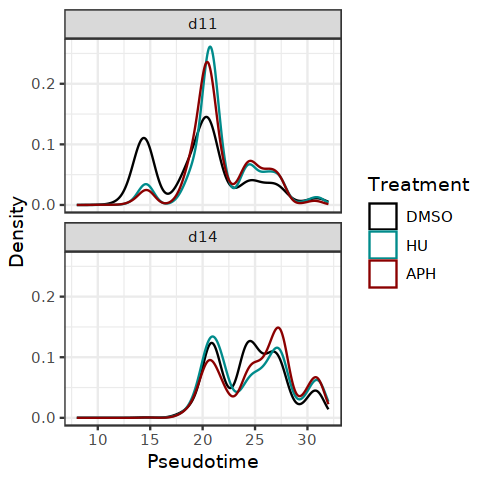

In [6]:
options(repr.plot.width=4, repr.plot.height=4)
ery@meta.data$Treatment = sapply(ery@meta.data$tx, toupper)
ery@meta.data$Treatment = factor(ery@meta.data$Treatment, levels=c("DMSO", "HU", "APH"))
ery@meta.data$Day = sapply(ery@meta.data$day, function(x) paste("d", x, sep=""))
ggplot(ery@meta.data, aes(x=sling, color=Treatment)) + geom_density() + 
scale_color_manual(values=c("black", "cyan4", "darkred")) +
facet_wrap(vars(Day), ncol = 1) + xlab("Pseudotime") + ylab("Density") +
theme_bw() + xlim(c(8, 32))
                           
ggsave("230607_bd391_pseudotime.pdf", width=4, height=4)

In [8]:
get_permuted_ks = function(v1, v2) {
    v = c(v1, v2)
    
    d = ks.test(v1, v2)$stat[[1]]
    print(d)
    permuted_d = c()
    for (i in 1:1000) {
        vs = sample(v)
        v1n = vs[1:length(v1)]
        v2n = vs[(length(v1+1):length(vs))]
        permuted_d = c(permuted_d, ks.test(v1n, v2n)$stat[[1]])
    }
    return(sum(d > permuted_d))
}


get_permuted_ks(subset(z, day == "14" & tx == "dmso")$sling, 
                subset(z, day == "14" & tx == "hu")$sling)  # 1000 for all

Warning message in ks.test.default(v1, v2):
“p-value will be approximate in the presence of ties”


[1] 0.09452273


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”
Warning message in ks.test.default(v1n, v2n):
“p-value will be approximate in the presence of ties”


[1] 1000

In [3]:
z = ery@meta.data
head(z)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,sample,RNA_snn_res.0.5,seurat_clusters,donor,tx,predicted.predicted_seurat.score,predicted.predicted_seurat,day,sling
,<fct>,<dbl>,<int>,<dbl>,<chr>,<fct>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>
AAACCCAAGACAAGCC-1,ery,5013,1164,0.03989627,donor804_14_hu,7,7,donor804,hu,0.8439966,1,14,22.30448
AAACCCAAGACATCCT-1,ery,697,287,0.28694405,donor804_14_aph,0,0,donor804,aph,0.9825632,7,14,27.54447
AAACCCAAGAGCATTA-1,ery,4929,766,0.20288091,donor800_14_aph,0,0,donor800,aph,0.8096007,7,14,26.69968
AAACCCAAGCCGGAAT-1,ery,20163,3018,0.89272430,donor800_11_aph,4,4,donor800,aph,1.0000000,1,11,20.32027
AAACCCACAACAACAA-1,ery,4964,621,0.06043513,donor800_14_hu,0,0,donor800,hu,0.8068553,7,14,27.56256
AAACCCACAACCAACT-1,ery,1532,555,0.00000000,donor800_11_dmso,4,4,donor800,dmso,0.7410474,1,11,17.62002


In [4]:
library(stats)
z = ery@meta.data
print("day11")
ks.test(subset(z, day == "11" & tx == "dmso")$sling, subset(z, day == "11" & tx == "hu")$sling)
ks.test(subset(z, day == "11" & tx == "dmso")$sling, subset(z, day == "11" & tx == "aph")$sling)
print("day14")
ks.test(subset(z, day == "14" & tx == "dmso")$sling, subset(z, day == "14" & tx == "hu")$sling)
ks.test(subset(z, day == "14" & tx == "dmso")$sling, subset(z, day == "14" & tx == "aph")$sling)
# ks.test(subset(z, sample=="donor804_11_dmso")$sling, subset(z, sample=="donor804_11_hu")$sling)
# ks.test(subset(z, sample=="donor804_11_dmso")$sling, subset(z, sample=="donor804_11_aph")$sling)

# ks.test(subset(z, sample=="donor800_11_dmso")$sling, subset(z, sample=="donor804_11_dmso")$sling)

# print("day14")
# ks.test(subset(z, sample=="donor800_14_dmso")$sling, subset(z, sample=="donor800_14_hu")$sling)
# ks.test(subset(z, sample=="donor800_14_dmso")$sling, subset(z, sample=="donor800_14_aph")$sling)

# ks.test(subset(z, sample=="donor804_14_dmso")$sling, subset(z, sample=="donor804_14_hu")$sling)
# ks.test(subset(z, sample=="donor804_14_dmso")$sling, subset(z, sample=="donor804_14_aph")$sling)

# ks.test(subset(z, sample=="donor800_14_dmso")$sling, subset(z, sample=="donor804_14_dmso")$sling)

[1] "day11"


Warning message in ks.test.default(subset(z, day == "11" & tx == "dmso")$sling, :
“p-value will be approximate in the presence of ties”



	Asymptotic two-sample Kolmogorov-Smirnov test

data:  subset(z, day == "11" & tx == "dmso")$sling and subset(z, day == "11" & tx == "hu")$sling
D = 0.28015, p-value < 2.2e-16
alternative hypothesis: two-sided


Warning message in ks.test.default(subset(z, day == "11" & tx == "dmso")$sling, :
“p-value will be approximate in the presence of ties”



	Asymptotic two-sample Kolmogorov-Smirnov test

data:  subset(z, day == "11" & tx == "dmso")$sling and subset(z, day == "11" & tx == "aph")$sling
D = 0.26535, p-value < 2.2e-16
alternative hypothesis: two-sided


[1] "day14"


Warning message in ks.test.default(subset(z, day == "14" & tx == "dmso")$sling, :
“p-value will be approximate in the presence of ties”



	Asymptotic two-sample Kolmogorov-Smirnov test

data:  subset(z, day == "14" & tx == "dmso")$sling and subset(z, day == "14" & tx == "hu")$sling
D = 0.094523, p-value = 5.163e-07
alternative hypothesis: two-sided


Warning message in ks.test.default(subset(z, day == "14" & tx == "dmso")$sling, :
“p-value will be approximate in the presence of ties”



	Asymptotic two-sample Kolmogorov-Smirnov test

data:  subset(z, day == "14" & tx == "dmso")$sling and subset(z, day == "14" & tx == "aph")$sling
D = 0.15914, p-value < 2.2e-16
alternative hypothesis: two-sided


## Plotting gene expression by pseudotime

In [443]:
#cds[rowData(cds)$gene_short_name %in% ciliated_genes,]
klein.combined@meta.data$sling = slingPseudotime(klein.cds)[,"Lineage2"]
head(klein.combined@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.5,seurat_clusters,sling
,<chr>,<dbl>,<int>,<dbl>,<fct>,<fct>,<dbl>
cd34pos_cd164pos_TCGCAATC.GGGAACCT,data1,13484,3599,7.868585,4,4,NA
cd34pos_cd164pos_CTTAGTGT.CTCAGAAT,data1,11613,3186,6.647722,6,6,NA
cd34pos_cd164pos_GGGTCATT.ATCTTTGT,data1,11458,3393,9.329726,0,0,11.79668
cd34pos_cd164pos_TGAATCCT.CGTGGATA,data1,12221,3316,8.722690,4,4,NA
cd34pos_cd164pos_TAGGTACG.CCCTTCAG,data1,11680,3170,9.383562,4,4,NA
cd34pos_cd164pos_GATTGGGA.AACTTAGC,data1,9923,3212,6.489973,6,6,NA


`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 5654 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 5654 rows containing missing values (`geom_point()`).”


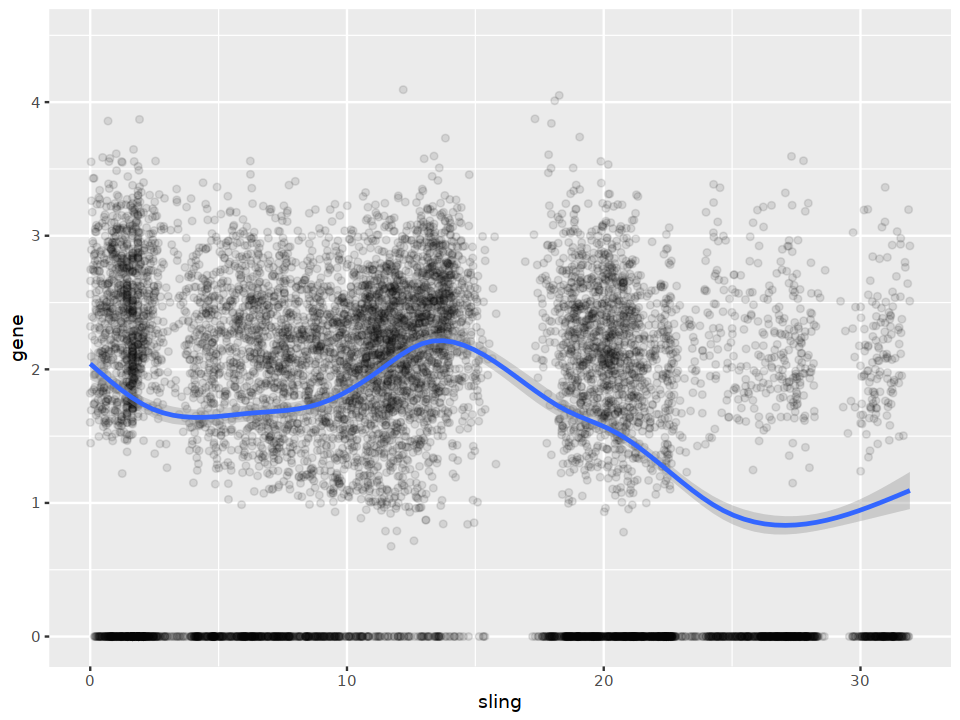

In [33]:
make_klein_gene_df = function(gene) {
    df = klein.combined@meta.data
    df$gene = FetchData(klein.combined, vars = gene)[,1]
    return(df)
}

options(repr.plot.width=8, repr.plot.height=6)
ggplot(make_klein_gene_df("FTL"), aes(x=sling, y=gene)) + geom_point(alpha=0.1) + geom_smooth()

In [8]:
make_gene_df = function(gene) {
    df = ery@meta.data
    df$gene = FetchData(ery, vars = gene)[,1]
    return(df)
}

plot_gene = function(g) {
    p = ggplot(make_gene_df(g), aes(x=sling, y=gene, color=tx)) + geom_point(alpha=0.1) + 
    geom_smooth() + facet_wrap(vars(donor, day)) + xlab("Pseudotime") + ylab("Expression") + 
    theme_bw() + xlim(10, 32) + ggtitle(g)
    
    if (g %in% rownames(klein.combined)) {
        p = p + geom_smooth(data=make_klein_gene_df(g), aes(x=sling, y=gene), colour="grey") 
    }
    return(p)
}

plot_gene_comb = function(g, legend = F, lab = F) {
    p = ggplot(make_gene_df(g), aes(x=sling, y=gene, color=Treatment)) + 
    rasterize(geom_point(alpha=0.05, size=0.3), dpi=300) + 
    geom_smooth() + scale_color_manual(values=c("black", "cyan4", "darkred")) +
    theme_bw() + xlim(10, 32) + ggtitle(g) 
    
    if (legend == F) p = p + guides(color="none") 
    if (lab == T) {
        p = p + xlab("Pseudotime") + ylab("Expression")
    } else {
        p = p + xlab("") + ylab("")
    }
    # if (g %in% rownames(klein.combined)) {
    #     p = p + geom_smooth(data=make_klein_gene_df(g), aes(x=sling, y=gene), colour="grey") 
    # }
    return(p)
}

`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = '

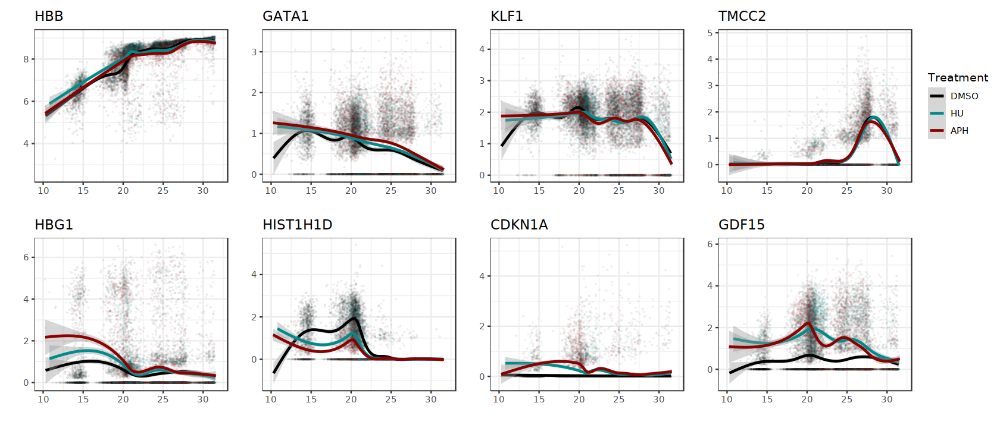

In [9]:
options(repr.plot.width=14, repr.plot.height=6)
plot_gene_comb("HBB") + plot_gene_comb("GATA1") + plot_gene_comb("KLF1") + plot_gene_comb("TMCC2", legend=T) +
plot_gene_comb("HBG1") + plot_gene_comb("HIST1H1D") + plot_gene_comb("CDKN1A") + plot_gene_comb("GDF15") + 
plot_layout(ncol=4)
ggsave("230607_bd391_genes.pdf", width=8, height=4)

`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missi

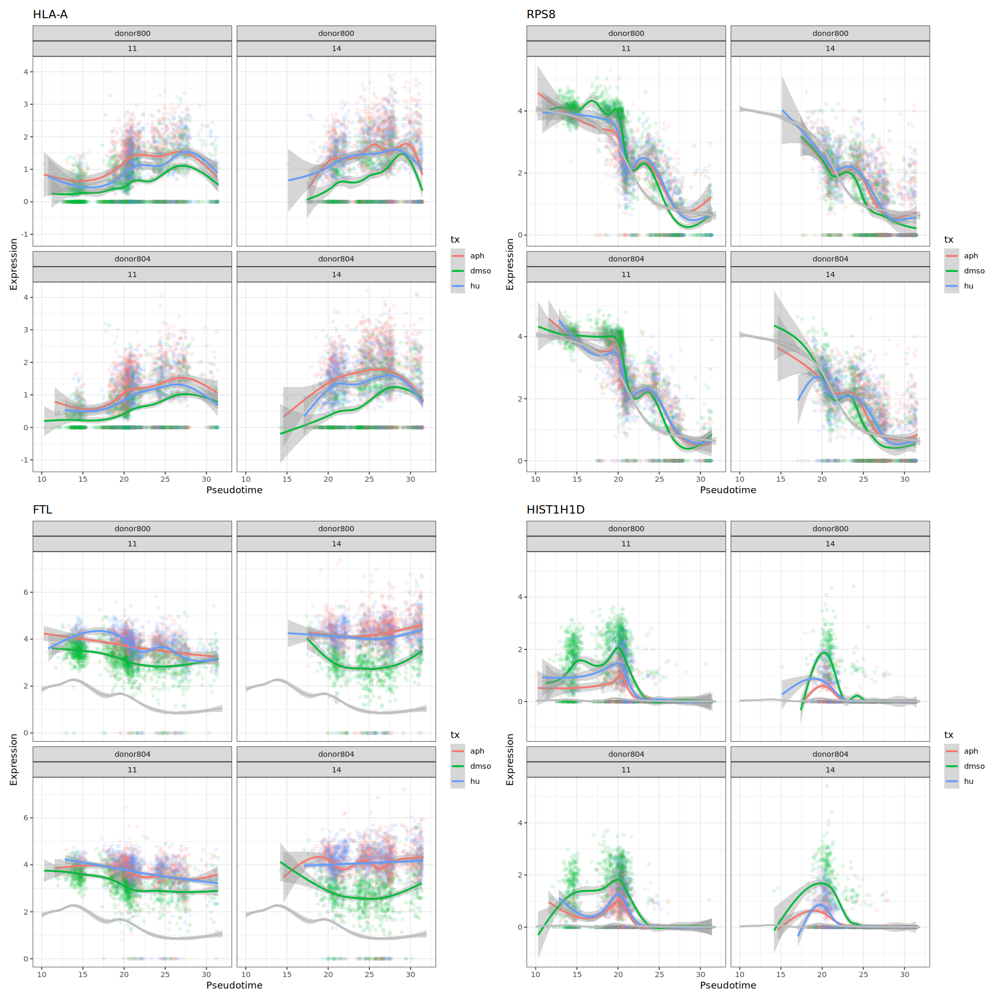

In [12]:
options(repr.plot.width=16, repr.plot.height=16)
(plot_gene("HLA-A") + plot_gene("RPS8"))/(plot_gene("FTL") + plot_gene("HIST1H1D"))

`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”


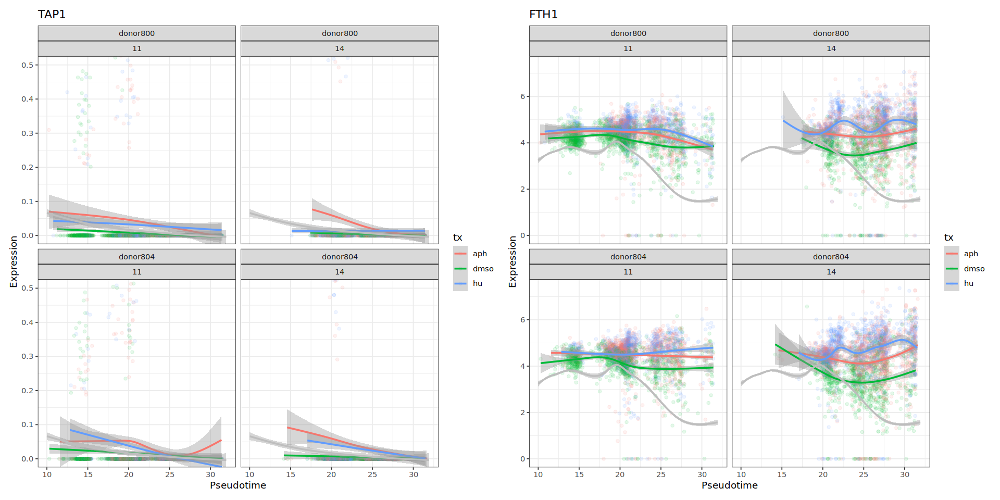

In [15]:
options(repr.plot.width=16, repr.plot.height=8)
(plot_gene("TAP1") + coord_cartesian(ylim=c(0, 0.5)) + plot_gene("FTH1"))

In [7]:
options(repr.plot.width=16, repr.plot.height=16)
(plot_gene("B2M") + plot_gene("PRG2"))/(plot_gene("GDF15") + plot_gene("CDKN1A"))

ERROR: Error in make_klein_gene_df(g): could not find function "make_klein_gene_df"


`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 

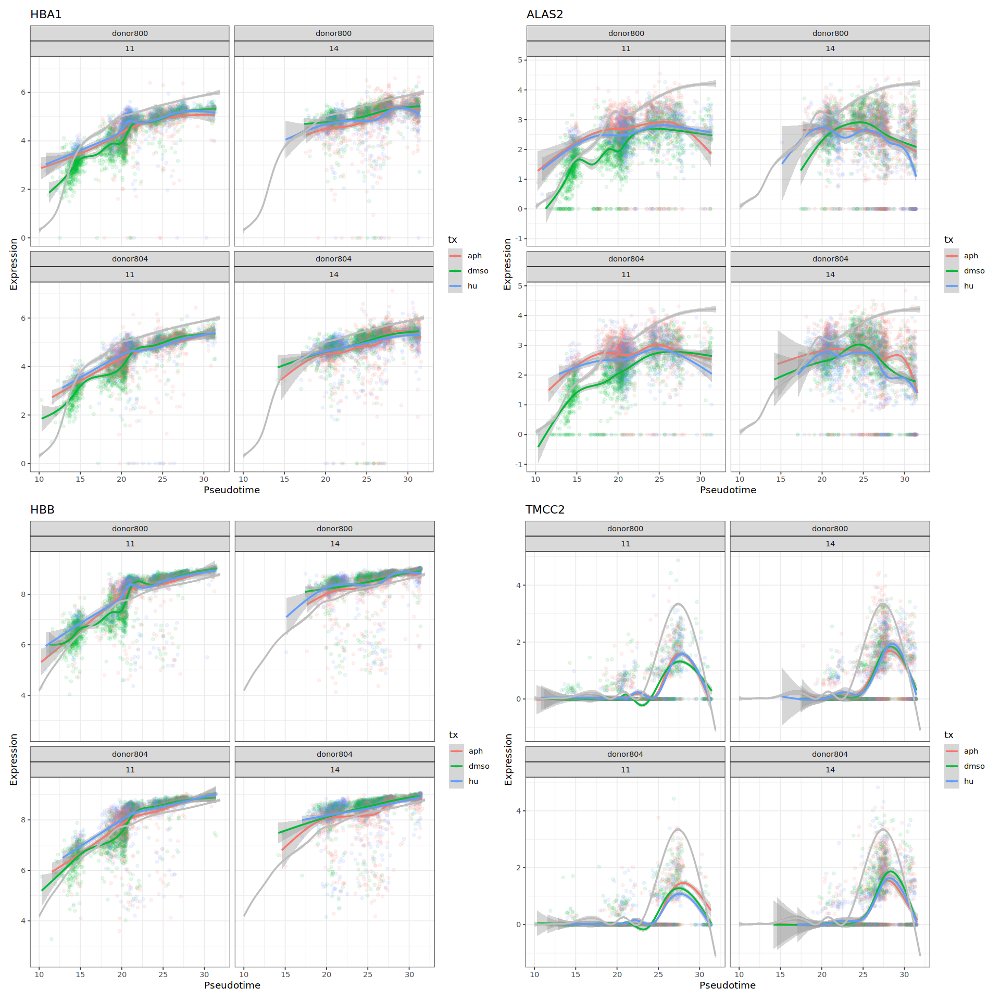

In [465]:
options(repr.plot.width=16, repr.plot.height=16)
(plot_gene("HBA1") + plot_gene("ALAS2"))/(plot_gene("HBB") + plot_gene("TMCC2"))

`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 37164 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 116 rows containing missing values (`geom_point()`).”
`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'
Warning message:
“Removed 116 rows containing non-finite values (`stat_smooth()`).”
`geom_smooth()` using method = 'gam' and formula = 

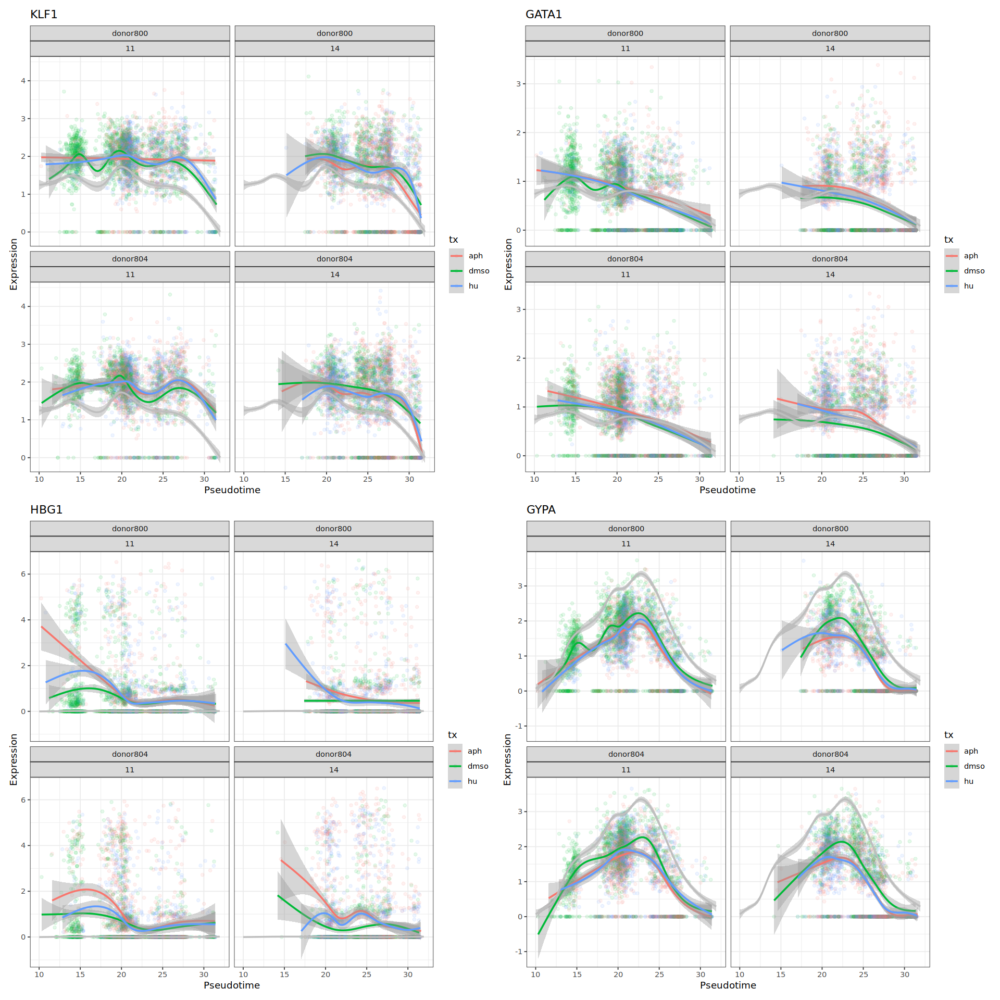

In [72]:
options(repr.plot.width=16, repr.plot.height=16)
(plot_gene("KLF1") + plot_gene("GATA1"))/(plot_gene("HBG1") + plot_gene("GYPA"))

## Look at treatment-specific marker genes within each decile
By showing that they are the same across treatments, that could give us confidence that the trajectories we are using are real  
  
Then we could do a differential gene expression testing for each bin

In [68]:
ery@meta.data$slingbin <- as.factor(as.numeric(cut_number(ery@meta.data$sling,10)))

In [72]:
dim(subset(ery@meta.data, tx == "hu" & slingbin == "3"))

[1] 362  14

In [92]:
markers_per_bin = list()
markers_per_bin[["hu"]] = list()
markers_per_bin[["aph"]] = list()
markers_per_bin[["dmso"]] = list()

In [97]:
markers_per_bin[["hu"]][[1]]

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MIF,0.000000e+00,1.788236,0.826,0.049,0.000000e+00
CD63,3.948340e-306,1.615034,0.846,0.057,9.348090e-302
TMSB10,9.537739e-286,1.576256,0.831,0.058,2.258155e-281
NME1,2.355920e-251,1.040151,0.779,0.060,5.577876e-247
SYNGR1,3.102890e-245,1.979645,0.836,0.082,7.346402e-241
GLRX,8.004153e-234,2.137239,0.821,0.084,1.895063e-229
NME2,2.172264e-231,2.219574,0.913,0.119,5.143052e-227
PPP1R14B,8.331332e-230,1.523255,0.826,0.083,1.972526e-225
PEBP1,5.530509e-228,1.744748,0.903,0.114,1.309403e-223


In [96]:
for (t in c("hu", "dmso", "aph")) {
    print(t)
    z = subset(ery, tx == t)
    Idents(object = z) <- "slingbin"
    for (i in 1:10) {
        print(i)
        
        ich = as.character(i)
        markers_per_bin[[t]][[ich]] = FindMarkers(z, ident.1 = ich, logfc.threshold = 1)
    }
}

[1] "hu"
[1] 1
[1] 2
[1] 3
[1] 4
[1] 5
[1] 6
[1] 7
[1] 8
[1] 9
[1] 10
[1] "dmso"
[1] 1
[1] 2
[1] 3
[1] 4
[1] 5
[1] 6
[1] 7
[1] 8
[1] 9
[1] 10
[1] "aph"
[1] 1
[1] 2
[1] 3
[1] 4
[1] 5
[1] 6
[1] 7
[1] 8
[1] 9
[1] 10


In [100]:
# get concordance
for (i in 1:10) {
    d = markers_per_bin[["dmso"]][[as.character(i)]]
    h = markers_per_bin[["hu"]][[as.character(i)]]
    a = markers_per_bin[["aph"]][[as.character(i)]]
    print(dim(subset(d, avg_log2FC > 1)))
    print(dim(subset(h, avg_log2FC > 1)))
    print(dim(subset(a, avg_log2FC > 1)))
}

[1] 321   5
[1] 254   5
[1] 251   5
[1] 15  5
[1] 128   5
[1] 141   5
[1] 13  5
[1] 22  5
[1] 37  5
[1] 19  5
[1] 4 5
[1] 19  5
[1] 8 5
[1] 2 5
[1] 33  5
[1] 6 5
[1] 6 5
[1] 4 5
[1] 26  5
[1] 1 5
[1] 12  5
[1] 61  5
[1] 38  5
[1] 47  5
[1] 45  5
[1] 29  5
[1] 21  5
[1] 25  5
[1] 16  5
[1] 20  5


In [102]:
# get concordance
for (i in 1:10) {
    d = markers_per_bin[["dmso"]][[as.character(i)]]
    h = markers_per_bin[["hu"]][[as.character(i)]]
    a = markers_per_bin[["aph"]][[as.character(i)]]
    print(dim(subset(d, avg_log2FC < -1)))
    print(dim(subset(h, avg_log2FC < -1)))
    print(dim(subset(a, avg_log2FC < -1)))
}

[1] 67  5
[1] 78  5
[1] 81  5
[1] 22  5
[1] 34  5
[1] 49  5
[1] 14  5
[1] 26  5
[1] 39  5
[1] 21  5
[1] 18  5
[1] 25  5
[1] 88  5
[1] 16  5
[1] 15  5
[1] 123   5
[1] 6 5
[1] 6 5
[1] 246   5
[1] 49  5
[1] 55  5
[1] 326   5
[1] 147   5
[1] 160   5
[1] 395   5
[1] 229   5
[1] 239   5
[1] 486   5
[1] 309   5
[1] 316   5


In [90]:
length(intersect(rownames(subset(aph1, avg_log2FC > 1)), 
          rownames(subset(dmso1, avg_log2FC > 1))))

[1] 215

In [88]:
length(rownames(subset(dmso1, avg_log2FC > 1)))  # 321
length(rownames(subset(aph1, avg_log2FC > 1)))  # 251  -- 215 intersect 
length(rownames(subset(hu1, avg_log2FC > 1)))  # 254  -- 223 intersect

[1] 321

[1] 251

[1] 254

# Save data

In [467]:
saveRDS(ery, "230424_ery_seurat.rds")
saveRDS(klein.combined, "230424_klein_combined_seurat.rds")